# Name: Bhavana Jaywant Pansare (40420569)


# Using Deep Learning & Satellite Imagery to Classify Greenspace in Belfast

Welcome to the Analytathon 2: Geospatial Data Science Challenge! The aim of this notebook is to:

1. Demonstrate how to explore and process geospatial data
2. Outline the high-level steps required to classify greenspaces

This notebook provides a structured methodology on how to complete such a task so while you are free to explore we strongly suggest you follow the outline.

<hr>

Satellite imagery is critical for a wide variety of applications from disaster management and recovery, to agriculture and military intelligence.

**In this challenge, your goal is to classify Greenspace in Belfast using satellite imagery**. 

The challenge uses publicly available satellite data from the [Sentinel-2 mission](https://sentinel.esa.int/web/sentinel/missions/sentinel-2), which captures high-resolution, multi-spectral imaging. 




# Step 0: Setup

#### Install necessary packages

In [1]:
# Import necessary libraries
import os
import shutil
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import csv
import glob
import torch
import torch.nn.functional as F
from torch import nn
from torch import optim
from torch.utils.data import Dataset, TensorDataset, DataLoader

import torchvision

import torchvision.transforms as transforms
from torchvision import models
from torchvision.transforms import RandomHorizontalFlip, RandomVerticalFlip, RandomRotation
from torchgeo.transforms import AppendNDVI
import pickle
import datetime
from timeit import default_timer as timer

import time
import random
import warnings
warnings.filterwarnings('ignore')
import itertools
from sklearn.metrics import roc_curve, roc_auc_score, confusion_matrix, precision_score, recall_score, accuracy_score
from sklearn.model_selection import train_test_split

from PIL import Image
from pathlib import Path
from matplotlib.colors import ListedColormap
from auxiliary_functions import (
    save_image,
    open_image,
    reclassify_worldcover_map,
    generate_image_paths,
    generate_masking_paths
)



#### Clean existing processing directories and create new

In [2]:
def create_processing_directories(processing_directories):
    """
    Create directories required by notebook
    Author: Michael
    """
    
    for directory in processing_directories:
        # Checking if the directory already exists
        if not os.path.exists(directory):
            # If the directory does not exist then create
            os.makedirs(directory, exist_ok=True)
            print(f'creating directory: {directory}')
        else:
            # If the directory already exists then print a message
            print(f'existing directory: {directory}')
                  
    
    
    

def clean_processing_directories(processing_directories, verbose = False):
    
    for directory in processing_directories:
        # Cleaning of the directory
        print(f'cleaning directory: {directory}')
        # Getting all the files within the directory
        files_to_remove = glob.glob(os.path.join(directory,'*'))
        for file in files_to_remove:
            # If verbose mode is on then print the name of each file which is being deleted
            if verbose:
                print(f'deleting file: {file}')
            # Remove the file
            os.remove(file)

# List the directories for processing the data
processing_directories = [
    './S2_True_Colour_Split',
    './S2_False_Colour_Split',
    './S2_True_Colour_Masked',
    './S2_False_Colour_Masked',
    './S2_Augmented',
    './S2_Augmented_Validation',
    './S2_Augmented_Train',
    './S2_Augmented_Test'
]

# Create the necessary directories
create_processing_directories(processing_directories)
# Cleaning up the directories
clean_processing_directories(processing_directories)

existing directory: ./S2_True_Colour_Split
existing directory: ./S2_False_Colour_Split
existing directory: ./S2_True_Colour_Masked
existing directory: ./S2_False_Colour_Masked
existing directory: ./S2_Augmented
existing directory: ./S2_Augmented_Validation
existing directory: ./S2_Augmented_Train
existing directory: ./S2_Augmented_Test
cleaning directory: ./S2_True_Colour_Split
cleaning directory: ./S2_False_Colour_Split
cleaning directory: ./S2_True_Colour_Masked
cleaning directory: ./S2_False_Colour_Masked
cleaning directory: ./S2_Augmented
cleaning directory: ./S2_Augmented_Validation
cleaning directory: ./S2_Augmented_Train
cleaning directory: ./S2_Augmented_Test


# Step 1: Data Exploration



<!DOCTYPE html>
<html>
<head>
<style>
.container {
  display: flex;
  jusPNGy-content: space-between;
}
.table {
  width: 40%;
  margin-left: auto;
  margin-right: auto;
}
td {
  color: white;
}
</style>
</head>
<h4>2020 ESA WorldCover</h4>
    <p>WorldCover is a global land cover map produced at 10m resolution based on a combination of both Sentinel-1 and Sentinel-2 data. Below is a table consisting of the various land cover class types observed in the Belfast area. This data represents the labelled ground truth the outputs of your model will be compared against.</p>
    <p></p>
  <div class="container" style="width:10%;">
    <table border="1" class="table">
      <thead>
        <tr>
          <th>Value</th>
          <th>Class Name</th>
          <th>Colour Code</th>
        </tr>
      </thead>
            <tbody>  
      <tr>
        <td>10</td>
        <td>Tree cover</td>
        <td style="background-color:#006400;">(0,100,0)</td>
      </tr>
      <tr>
        <td>20</td>
        <td>Shrubland</td>
        <td style="background-color:#FFBB22;">(255,187,34)</td>
      </tr>
      <tr>
        <td>30</td>
        <td>Grassland</td>
        <td style="background-color:#FFFF4C;">(255,255,76)</td>
      </tr>
      <tr>
        <td>40</td>
        <td>Cropland</td>
        <td style="background-color:#F096FF;">(240,150,255)</td>
      </tr>
      <tr>
        <td>50</td>
        <td>Builtup</td>
        <td style="background-color:#FA0000;">(250,0,0)</td>
      </tr>
      <tr>
        <td>60</td>
        <td>Bare/sparse vegetation</td>
        <td style="background-color:#B4B4B4;">(180,180,180)</td>
      </tr>
      <tr>
        <td>70</td>
        <td>Snow and Ice</td>
        <td style="background-color:#F0F0F0;">(240,240,240)</td>
      </tr>
      <tr>
        <td>80</td>
        <td>Permanent water bodies</td>
        <td style="background-color:#0064C8;">(0,100,200)</td>
      </tr>
      <tr>
        <td>90</td>
        <td>Herbaceous wetland</td>
        <td style="background-color:#0096A0;">(0,150,160)</td>
      </tr>
      <tr>
        <td>95</td>
        <td>Mangroves</td>
        <td style="background-color:#00CF75;">(0,207,117)</td>
      </tr>
    <tr>
        <td>100</td>
        <td>Moss and lichen</td>
        <td style="background-color:#FAE6A0;">(250,230,160)</td>
      </tr>
      </tbody>
    </table>
  </div>


As this is a binary image segmentation task, the image has been reclassfied into two land cover classes: Greenspace and Urban. 

Run the method below to generate the reclassfied worldcover map. The new labelled map will be stored in the worldcover folder.

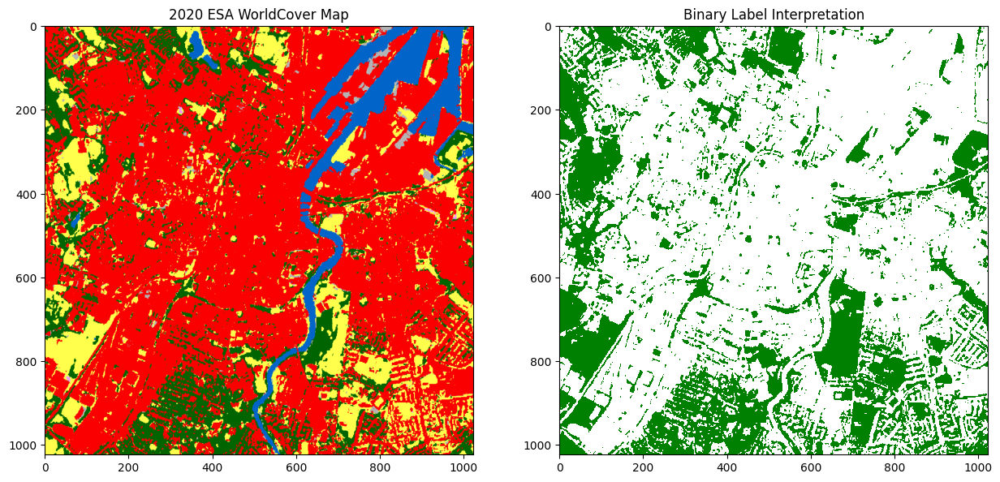

In [3]:
# Reclassifies the values in global land cover map for making it simpler
reclassify_worldcover_map()

#### Metadata

Let's invesigate the metadata.

You have one row per chip, and each `chip_id` is unique. There are columns for:

- `chip_id`: Index of the chip

- `date`: Date the satellite image was captured.

- `cloud_coverage` and `water_coverage`: Metrics collected for each Scene Mask

In [4]:
# Load metadata from a CSV file into a Dataframe
meta = pd.read_csv("./metadata.csv",dtype={'chip_id':'string','datetime':'string'})
# Display first 5 records
meta.head()

,chip_id,date,cloud_coverage,water_coverage
0,20190116,2019-01-16,1.097,17.091
1,20190202,2019-02-02,0.583,16.338
2,20190207,2019-02-07,0.720,16.543
3,20190406,2019-04-06,0.364,14.220
4,20190627,2019-06-27,0.438,12.495


#### Satellite Images

Next, let's explore the satellite images.

The S2_chips folder consists of 60 "chips". Each chip is imagery of a specific area captured at a specific point in time. There are 3 images associated with each chip. The image details are provided below:

<table border="1" class="table" style="width:80%; margin-left:auto; margin-right:auto">
  <thead>
    <tr style="text-align: right;">
      <th>Composite</th>
      <th>Description</th>
      <th>Pixel Resolution</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <td>True Colour</td>
      <td>True colour image that accurately represents the colours as they would appear to the human eye.</td>
      <td>10 m</td>
    </tr>
    <tr>
      <td>False Colour</td>
      <td>False colour highlights specific features not visible in true colour.</td>
      <td>10 m</td>
    </tr>
    <tr>
      <td>Scene_Mask</td>
      <td>This layer can be used to mask out certain areas of the image that are not relevant to the analysis, such as clouds, shadows, and water bodies.</td>
      <td>10 m</td>
    </tr>
  </tbody>
</table>

PNG images are useful for working with satellite imagery because they are lossless, meaning that they do not lose any image quality when they are compressed or saved. 




Run the function below to append the image paths to the metadata dataframe.

In [5]:
# Generate the full image paths for each chip
chip_df = generate_image_paths(meta, label_dir="./Worldcover_Map")
# Display first five records
chip_df.head(5)

,chip_id,date,cloud_coverage,water_coverage,True_Colour_path,False_Colour_path,Scene_Mask_path,Label_path
0,20190116,2019-01-16,1.097,17.091,./S2_chips/20190116/True_Colour.png,./S2_chips/20190116/False_Colour.png,./S2_chips/20190116/Scene_Mask.png,./Worldcover_Map/2020_ESA_WorldCover_Map_Recla...
1,20190202,2019-02-02,0.583,16.338,./S2_chips/20190202/True_Colour.png,./S2_chips/20190202/False_Colour.png,./S2_chips/20190202/Scene_Mask.png,./Worldcover_Map/2020_ESA_WorldCover_Map_Recla...
2,20190207,2019-02-07,0.720,16.543,./S2_chips/20190207/True_Colour.png,./S2_chips/20190207/False_Colour.png,./S2_chips/20190207/Scene_Mask.png,./Worldcover_Map/2020_ESA_WorldCover_Map_Recla...
3,20190406,2019-04-06,0.364,14.220,./S2_chips/20190406/True_Colour.png,./S2_chips/20190406/False_Colour.png,./S2_chips/20190406/Scene_Mask.png,./Worldcover_Map/2020_ESA_WorldCover_Map_Recla...
4,20190627,2019-06-27,0.438,12.495,./S2_chips/20190627/True_Colour.png,./S2_chips/20190627/False_Colour.png,./S2_chips/20190627/Scene_Mask.png,./Worldcover_Map/2020_ESA_WorldCover_Map_Recla...


# Step 2: Data Pre-processing


<!DOCTYPE html>
<html>
<head>
<style>
.container {
  display: flex;
  jusPNGy-content: space-between;
}
.table {
  width: auto;
  margin-left: auto;
  margin-right: auto;
}
td {
  color: white;
}
</style>
</head>
<body>
<h4>Satellite Scene Masking</h4>
  <p>Scene masks can consist of twelve different classifications including classes of clouds, vegetation, soils/desert, water and snow. It does not constitute a land cover classification map in a strict sense.</p>
  
  <div class="container" style="width:10%;">
  <table class="table">
    <thead>
      <tr>
        <th>Mask Label</th>
        <th>Class Name</th>
        <th>Colour Code</th>
      </tr>
    </thead>
    <tbody>
      <tr>
        <td>0</td>
        <td>NODATA</td>
        <td style="background-color:#000000;">(0,0,0)</td>
      </tr>
      <tr>
        <td>1</td>
        <td>Saturated or Defective</td>
        <td style="background-color:#FF0000;">(255,0,0)</td>
      </tr>
      <tr>
        <td>2</td>
        <td>Dark Areas</td>
        <td style="background-color:#2F2F2F;">(47,47,47)</td>
      </tr>
      <tr>
        <td>3</td>
        <td>Cloud Shadow</td>
        <td style="background-color:#643200;">(100,50,0)</td>
      </tr>
      <tr>
        <td>4</td>
        <td>Vegetation</td>
        <td style="background-color:#00A000;">(0,160,0)</td>
      </tr>
      <tr>
        <td>5</td>
        <td>Bare Ground</td>
        <td style="background-color:#FFE65A;">(255,230,90)</td>
      </tr>
      <tr>
        <td>6</td>
        <td>Water</td>
        <td style="background-color:#0000FF;">(0,0,255)</td>
      </tr>
      <tr>
        <td>7</td>
        <td>Unclassified</td>
        <td style="background-color:#808080;">(128,128,128)</td>
      </tr>
      <tr>
        <td>8</td>
        <td>Cloud</td>
        <td style="background-color:#C0C0C0;">(192,192,192)</td>
      </tr>
      <tr>
        <td>9</td>
        <td>Definitely Cloud</td>
        <td style="background-color:#FFFFFF;">(255,255,255)</td>
      </tr>
      <tr>
        <td>10</td>
        <td>Thin Cloud</td>
        <td style="background-color:#64C8FF;">(100,200,255)</td>
      </tr>
      <tr>
        <td>11</td>
        <td>Snow or Ice</td>
        <td style="background-color:#FF00FF;">(255,150,255)</td>
      </tr>
    </tbody>
  </table>
</div>

The function below will generate folders for the masked true and false colour datasets.

In [6]:
# Generate paths for masked images
masking_df = generate_masking_paths(chip_df)
# Display first five records
masking_df.head(5)

,chip_id,date,cloud_coverage,water_coverage,True_Colour_path,False_Colour_path,Scene_Mask_path,Label_path,True_Colour_M_path,True_Colour_M_label_path,False_Colour_M_path,False_Colour_M_label_path
0,20190116,2019-01-16,1.097,17.091,./S2_chips/20190116/True_Colour.png,./S2_chips/20190116/False_Colour.png,./S2_chips/20190116/Scene_Mask.png,./Worldcover_Map/2020_ESA_WorldCover_Map_Recla...,./S2_True_Colour_Masked/True_Colour_M_20190116...,./S2_True_Colour_Masked/True_Colour_M_20190116...,./S2_False_Colour_Masked/False_Colour_M_201901...,./S2_False_Colour_Masked/False_Colour_M_201901...
1,20190202,2019-02-02,0.583,16.338,./S2_chips/20190202/True_Colour.png,./S2_chips/20190202/False_Colour.png,./S2_chips/20190202/Scene_Mask.png,./Worldcover_Map/2020_ESA_WorldCover_Map_Recla...,./S2_True_Colour_Masked/True_Colour_M_20190202...,./S2_True_Colour_Masked/True_Colour_M_20190202...,./S2_False_Colour_Masked/False_Colour_M_201902...,./S2_False_Colour_Masked/False_Colour_M_201902...
2,20190207,2019-02-07,0.720,16.543,./S2_chips/20190207/True_Colour.png,./S2_chips/20190207/False_Colour.png,./S2_chips/20190207/Scene_Mask.png,./Worldcover_Map/2020_ESA_WorldCover_Map_Recla...,./S2_True_Colour_Masked/True_Colour_M_20190207...,./S2_True_Colour_Masked/True_Colour_M_20190207...,./S2_False_Colour_Masked/False_Colour_M_201902...,./S2_False_Colour_Masked/False_Colour_M_201902...
3,20190406,2019-04-06,0.364,14.220,./S2_chips/20190406/True_Colour.png,./S2_chips/20190406/False_Colour.png,./S2_chips/20190406/Scene_Mask.png,./Worldcover_Map/2020_ESA_WorldCover_Map_Recla...,./S2_True_Colour_Masked/True_Colour_M_20190406...,./S2_True_Colour_Masked/True_Colour_M_20190406...,./S2_False_Colour_Masked/False_Colour_M_201904...,./S2_False_Colour_Masked/False_Colour_M_201904...
4,20190627,2019-06-27,0.438,12.495,./S2_chips/20190627/True_Colour.png,./S2_chips/20190627/False_Colour.png,./S2_chips/20190627/Scene_Mask.png,./Worldcover_Map/2020_ESA_WorldCover_Map_Recla...,./S2_True_Colour_Masked/True_Colour_M_20190627...,./S2_True_Colour_Masked/True_Colour_M_20190627...,./S2_False_Colour_Masked/False_Colour_M_201906...,./S2_False_Colour_Masked/False_Colour_M_201906...


Scene Masks are used to remove unwanted class types from the image which helps improve model performance. We have applied the masking below which will output the masked true and false colour images to separate folders with the associated masked worldcover label.

You can experiment here to explore the effect of running different model with different masking options.

In [7]:
# Define a dictionary for mapping scene mask class to specific RGB colour
scene_mask_class_dict = {
    0: (0, 0, 0),       # NODATA - MAGENTA
    1: (255, 0, 0),     # Saturated or Defective - RED
    2: (47, 47, 47),    # Dark Areas - BLACK
    3: (100, 50, 0),    # Cloud Shadow - DARK GREY
    4: (0, 160, 0),     # Vegetation - GREEN
    5: (255, 230, 90),  # Bare Ground - BROWN
    6: (0, 0, 255),     # Water - BLUE
    7: (128, 128, 128), # Unclassified - MAROON
    8: (192, 192, 192), # Cloud - LIGHT GREY
    9: (255, 255, 255), # Definitely Cloud - WHITE
    10: (100, 200, 255),# Thin Cloud - LIGHT BLUE
    11: (255, 150, 255) # Snow or Ice - PINK
}

# Loop through each row in the Dataframe 'masking_df'
for i, row in masking_df.iterrows():

    # Opens scene mask, label, true colour, and false colour images
    scene_mask = open_image(row.Scene_Mask_path)
    label = open_image(row.Label_path)
    true_colour = open_image(row.True_Colour_path)
    false_colour = open_image(row.False_Colour_path)

    # Create a mask for the unwanted classes such as water, clouds, thin clouds, etc.
    mask = ((scene_mask==1) | (scene_mask==6) | (scene_mask==8) | (scene_mask==9) | (scene_mask==10) | (scene_mask==11))

    # Apply the mask to the images and labels
    masked_true_colour = np.where(np.expand_dims(mask, axis=2), 255, true_colour)
    masked_false_colour = np.where(np.expand_dims(mask, axis=2), 255, false_colour)
    masked_label = np.where(mask, 0, label)

    # Save the masked images and labels to new paths
    save_image(masked_true_colour, row.True_Colour_M_path)
    save_image(masked_label, row.True_Colour_M_label_path)

    save_image(masked_false_colour, row.False_Colour_M_path)
    save_image(masked_label, row.False_Colour_M_label_path)


#### Image Splitting

Now we split the true colour maksed dataset into a size better suited for machine learning. What would you change to split the false colour dataset? You can also experiment here with different split sizes to understand the impact on model performance.

The function below will generate a folder containing our split dataset with its corresponding labels.

In [8]:
# Retrieve the 75th percentile of cloud coverage data
max_allowed_cloudiness = chip_df.describe()["cloud_coverage"]["75%"]

In [9]:
# Number of splits per dimension
split_size = 4 

# Create the target directory if does not exist
target_directory = "S2_True_Colour_Split"
if not os.path.exists(target_directory):
    os.makedirs(target_directory, exist_ok=True)

# Iterate over each image of path
for i, (image_path, label_path, cloud_coverage) in enumerate(zip(masking_df["True_Colour_M_path"], masking_df["True_Colour_M_label_path"], masking_df['cloud_coverage'])):
    
    # Skip the processing images with its cloud coverage
    if cloud_coverage > max_allowed_cloudiness:
        continue
    
    # Check if the files exist along with image and label
    if os.path.exists(image_path) and os.path.exists(label_path):
        # Load the images and labels
        img = open_image(image_path)
        label = open_image(label_path)

        # Retrieve the chip id from the Dataframe by using the current index
        chip_id = masking_df.at[i, "chip_id"]

        # Split the images into 16 smaller images and calculate its size
        img_height, img_width, _ = img.shape
        split_height = img_height // split_size
        split_width = img_width // split_size

        # Iterate over each grid position
        for row in range(split_size):
            for col in range(split_size):
                # Calculate the boundaries
                start_row = row * split_height
                end_row = (row + 1) * split_height
                start_col = col * split_width
                end_col = (col + 1) * split_width

                # Extract the smaller image and label of each segment
                split_img = img[start_row:end_row, start_col:end_col, :]
                split_label = label[start_row:end_row, start_col:end_col]

                # Save the smaller images with indexed filenames in its respective files
                img_filename = f"{chip_id}_{row}_{col}_img.png"
                label_filename = f"{chip_id}_{row}_{col}_label.png"
                img_filepath = os.path.join(target_directory, img_filename)
                label_filepath = os.path.join(target_directory, label_filename)

                # Save the images and labels only if the split_label has a value greater than 0 present
                if np.any(split_label > 0):
                    save_image(split_img, img_filepath)
                    save_image(split_label, label_filepath)
    else:
        print(f"File not found: {image_path} or {label_path}")

In [10]:
# Copy of Deloitte's code for the false image split

# Splits into 4 parts each axis, creating 16 smaller images
split_size = 4

# Ensure the target directory for storing split images exists if not then create directory
target_directory = "S2_False_Colour_Split"
if not os.path.exists(target_directory):
    os.makedirs(target_directory, exist_ok=True)

# Iterate through each entry in the masking dataframe to process with the false colour images
for i, (image_path, label_path, cloud_coverage) in enumerate(zip(masking_df["False_Colour_M_path"], masking_df["False_Colour_M_label_path"], masking_df['cloud_coverage'])):
    
    # Skip the processing for images where cloud coverage is present
    if cloud_coverage > max_allowed_cloudiness:
        continue
    
    # Verify that both the image file and the label exist
    if os.path.exists(image_path) and os.path.exists(label_path):
        # Load the false images and labels
        img = open_image(image_path)
        label = open_image(label_path)

        # Retrieve the chip identifier from the Dataframe
        chip_id = masking_df.at[i, "chip_id"]

        # Split the images into 16 smaller images and prints its shape
        img_height, img_width, _ = img.shape
        split_height = img_height // split_size
        split_width = img_width // split_size

        # Iterate over the defined grid
        for row in range(split_size):
            for col in range(split_size):
                # Calculate the indices for splitting the image for height, width, and width
                start_row = row * split_height
                end_row = (row + 1) * split_height
                start_col = col * split_width
                end_col = (col + 1) * split_width

                # Extract the smaller image and label for each segmented
                split_img = img[start_row:end_row, start_col:end_col, :]
                split_label = label[start_row:end_row, start_col:end_col]

                # Save the smaller images with indexed filenames into respective files
                img_filename = f"{chip_id}_{row}_{col}_img.png"
                label_filename = f"{chip_id}_{row}_{col}_label.png"
                img_filepath = os.path.join(target_directory, img_filename)
                label_filepath = os.path.join(target_directory, label_filename)

                # Save the images only if the split labels has a value greater than 0 present
                if np.any(split_label > 0):
                    save_image(split_img, img_filepath)
                    save_image(split_label, label_filepath)
    else:
        # Print an error message if one of the image or label file is missing
        print(f"File not found: {image_path} or {label_path}")

#### Create Augmentations

In [11]:
"""
Create Augmentations
Authors: Maria, Michael
"""
# Define the maximum number of augmentations
max_num_augmentations = 6
# List of transformation compositions such as rotations, flips, and conversion to tensor
augmentation_transforms_list = [
        transforms.Compose([transforms.RandomRotation(degrees=(0,0)),transforms.ToTensor() ]),
        transforms.Compose([transforms.RandomRotation(degrees=(90,90)),transforms.ToTensor() ]),
        transforms.Compose([transforms.RandomRotation(degrees=(180,180)),transforms.ToTensor() ]),
        transforms.Compose([transforms.RandomRotation(degrees=(270,270)),transforms.ToTensor() ]),
        transforms.Compose([transforms.RandomHorizontalFlip(p=0.5),transforms.ToTensor() ]),
        transforms.Compose([transforms.RandomVerticalFlip(p=0.5),transforms.ToTensor() ]),
]
# Calculate the number of transformations in the list
num_transforms = len(augmentation_transforms_list)
# Initialize a list to store IDs of image split
white_list_idx = []
# Looping through each entry
for _, row_chip in chip_df.iterrows():
    img_id = row_chip["chip_id"]
    
    # Looping through each split of image of 4x4 grid
    for split_row_idx in range(4):
        for split_col_idx in range(4):
            split_id = f"{img_id}_{split_row_idx}_{split_col_idx}"
            
            # Create file paths for true color, false color, and label images
            true_colour_img_path = f"S2_True_Colour_Split/{split_id}_img.png"
            false_colour_img_path = f"S2_False_Colour_Split/{split_id}_img.png"
            label_path = f"S2_False_Colour_Split/{split_id}_label.png"
            
            # Check if all required files exist if not then create
            if not (os.path.exists(true_colour_img_path) \
                    and os.path.exists(false_colour_img_path) \
                    and os.path.exists(label_path)):
                continue
            white_list_idx += [split_id]
            
            # Apply each transformation to the true color, false color, and label images
            for idx_transform in range(num_transforms):
                current_transform = augmentation_transforms_list[idx_transform]
                transformed_img_id = f"{img_id}_{split_row_idx}_{split_col_idx}_{idx_transform}"
                
                # Open the images using Pillow
                seed = np.random.randint(99999999) # Set a random seed
                true_colour_image = Image.open(true_colour_img_path)
                false_colour_image = Image.open(false_colour_img_path)
                label_image = Image.open(label_path)
                
                # Apply the same transformation to each image using the same seed
                np.random.seed(seed)
                transformed_true_colour_image = current_transform(true_colour_image)
                np.random.seed(seed)
                transformed_false_colour_image = current_transform(false_colour_image)
                np.random.seed(seed)
                
                # Convert label image to binary format
                transformed_label_image = current_transform(label_image)
                label = transformed_label_image.gt(0).int() 
                
                # Concatenate the transformed true and false color images into a single tensor
                image = torch.cat((transformed_true_colour_image, transformed_false_colour_image), dim = 0)
                
                # Append NDVI to image tensor
                image = AppendNDVI(index_red=0, index_nir=3)(image).squeeze(0)
                
                # Save the transformed image and label tensors
                torch.save(image, f"S2_Augmented/{transformed_img_id}_img.pt")
                torch.save(label, f"S2_Augmented/{transformed_img_id}_label.pt")

# Remove duplicate entries to ensure unique ID
white_list_idx = list(set(white_list_idx))

# Step 3: Dataset Generation

#### Create validation data

In [12]:
# Calculate the total number of non-transformed images 
num_images_non_transformed = len(white_list_idx)

# Compute the size of the training set as 70%
training_set_size = int(np.floor(0.7 * num_images_non_transformed))

# Compute the size of the test set as 25%
test_set_size = int(np.floor(0.25 * num_images_non_transformed))

# Calculate the size of the validation set as the remaining images after allocating to training and test sets
test_validation = num_images_non_transformed - training_set_size - test_set_size

# Printing the sizes of each dataset
print(f"Total number of available segments: {num_images_non_transformed}")
print(f"Training.......... {training_set_size}")
print(f"Test.......... {test_set_size}")
print(f"Validation.......... {test_validation}")

# Set a random seed
np.random.seed(seed) 

# Generate a random permutation
rperm = np.random.permutation(num_images_non_transformed)

# Extract indices for the training set
training_set_idx = np.take(white_list_idx, rperm[0:training_set_size])

# Extract indices for the test set
test_set_idx = np.take(white_list_idx, rperm[training_set_size:training_set_size+test_set_size])

# Extract indices for the validation set
validation_set_idx = np.take(white_list_idx, rperm[training_set_size+test_set_size:])

Total number of available segments: 720
Training..... 503
Test......... 180
Validation... 37


#### Create Test/Train split data

In [13]:
# Define the names of the directories for the training, test, and validation datasets
training_folder, test_folder, validation_folder = "S2_Augmented_Train", "S2_Augmented_Test", "S2_Augmented_Validation"

# Create directories for training, test, and validation sets
create_processing_directories([training_folder, test_folder, validation_folder])

# Define a function to move image and label files
def move_image_label_files(designation, set_images):
    
    # Iterate over each image index in the set
    for training_img_idx in set_images:
        for idx_transform in range(num_transforms):
            # Create the filename for the current image and label
            curr_idx = f"{training_img_idx}_{idx_transform}"
            curr_img_fname = f"S2_Augmented/{curr_idx}_img.pt"
            curr_label_fname = f"S2_Augmented/{curr_idx}_label.pt"   
            # Copy the image file to the designated directory
            shutil.copyfile(curr_img_fname, designation + "/" + curr_idx + "_img.pt")
            # Copy the label file to the designated directory
            shutil.copyfile(curr_label_fname, designation + "/" + curr_idx + "_label.pt")

# Calling the function
move_image_label_files(training_folder, training_set_idx)
move_image_label_files(test_folder, test_set_idx)
move_image_label_files(validation_folder, validation_set_idx)

existing directory: S2_Augmented_Train
existing directory: S2_Augmented_Test
existing directory: S2_Augmented_Validation


#### Create DataLoaders

Creates global variable (train_dataloader, test_dataloader) for use in training

In [21]:
"""
Create Dataloaders
Authors: Maria, Michael
"""
class AugmentedDataset(Dataset):

    def __init__(self, list_ids, directory, num_transforms=2):
        super().__init__() # Calling the constructor
        ids = [] # Initialize an empty list to store IDs
        # Loop through each segment ID
        for segment_id in list_ids:
            # For each segment, create IDs for each transformation
            for idx_transform in range(num_transforms):
                # Append each transformation ID to list
                ids += [f"{segment_id}_{idx_transform}"]
        self.list_ids = ids # Store all IDs in variable
        self.directory = directory
        
        
    def __len__(self):
        return len(self.list_ids) # Returns the length of the list of ID
      
    # Created method to retrieve a single item from the dataset
    def __getitem__(self, idx):
        current_id = self.list_ids[idx] # Get the ID of the current index
        # Load the image file
        image = torch.load(os.path.join(self.directory, f'{current_id}_img.pt'))
        # Load the label file
        labels = torch.load(os.path.join(self.directory, f'{current_id}_label.pt'))
        return image, labels

# Instantiate an AugmentedDataset
augmented_dataset_1 = AugmentedDataset(training_set_idx, "S2_Augmented_Train")
# Print the number of items in the dataset
len(augmented_dataset_1)

1006

In [22]:
# Define the batch size for loading data
batch_size = 10

# Specify the directories where training and testing data are stored
source_train_directory = 'S2_Augmented_Train'
source_test_directory = 'S2_Augmented_Test'

# Create an instance of the AugmentedDataset for the training data
train_dataset = AugmentedDataset(training_set_idx, training_folder, num_transforms=2)
# Create an instance of the AugmentedDataset for the testing data
test_dataset = AugmentedDataset(test_set_idx, test_folder, num_transforms=2)
# Create a DataLoader for the training dataset
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
# Create a DataLoader for the testing dataset
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True)

/tmp/ipykernel_2075176/599967286.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, 2)


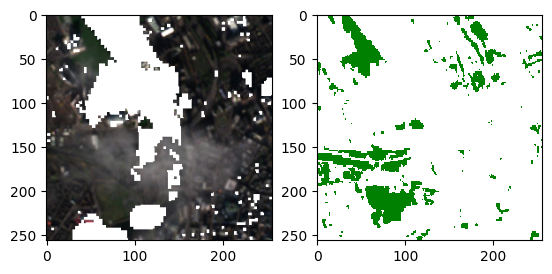

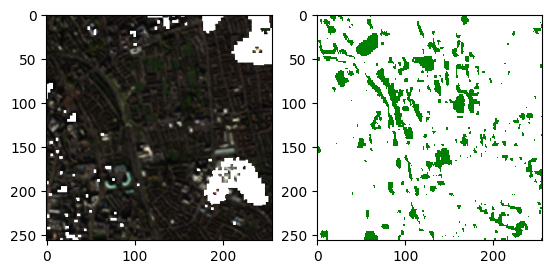

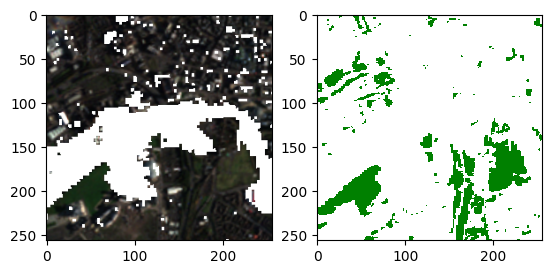

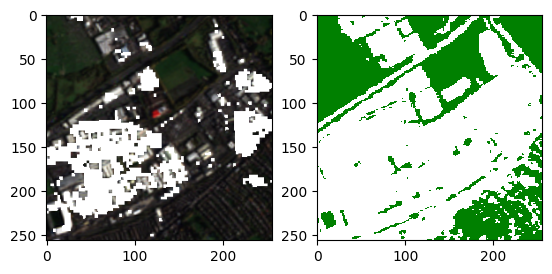

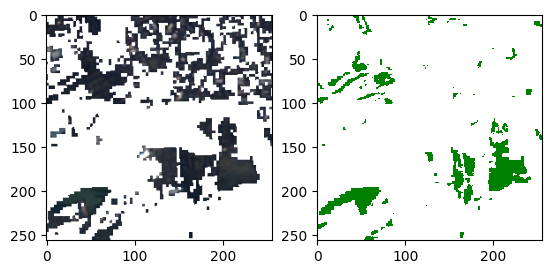

...

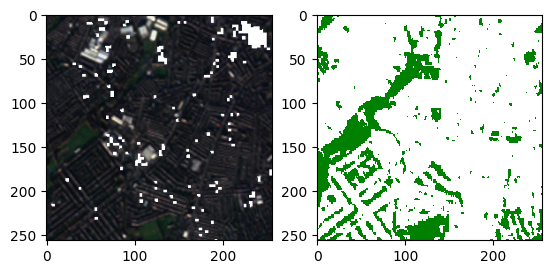

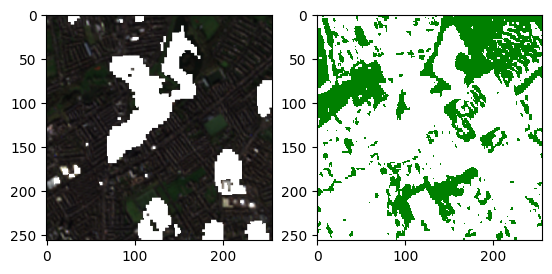

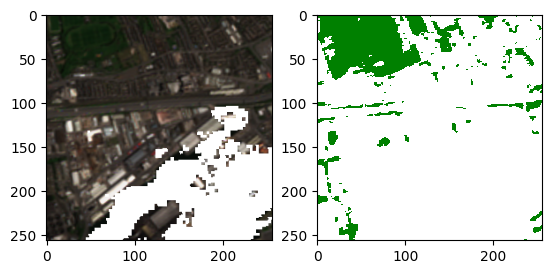

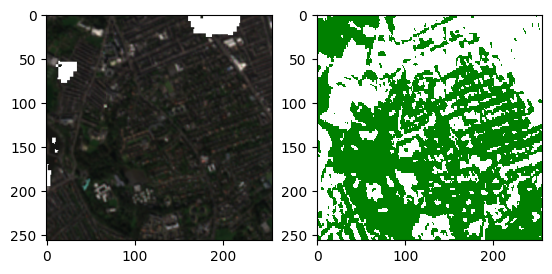

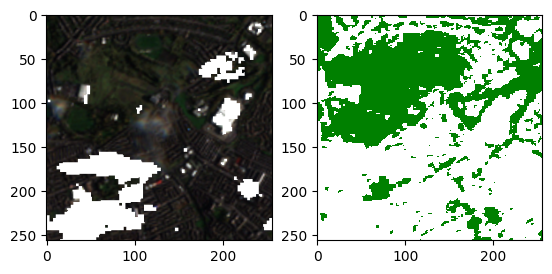

In [71]:
# Display the images and labels from train dataloader
for mybatch, mylabelbatch in train_dataloader:
    img = mybatch[0]
    lab = mylabelbatch[0]
    fig, ax = plt.subplots(1, 2)
    ax[0].imshow(img.transpose(2,0)[:, :, :3])
    greenspace_urban_cmap = ListedColormap(['white', 'green'])
    ax[1].imshow(lab.transpose(2,0).gt(0).int(), cmap=greenspace_urban_cmap)


# Step 4: Model Creation

Code for machine learning models

#### Resnet
Author: Marietta (Maria)

In [15]:
"""
Author: Maria     
"""
class ResNet(nn.Module):
    def __init__(self, num_classes):
        # Initialize the superclass
        super(ResNet, self).__init__()
        # Load a pretrained ResNet-34 model
        resnet = models.resnet34(weights='DEFAULT')
        self.features = nn.Sequential(*list(resnet.children())[:-2])  # Remove the last two layer features

        # Add convolutional layers to convert the features to pixel-wise prediction
        # A convolutional layer that reduces the channel depth from 512 to 128
        self.conv1 = nn.Conv2d(512, 128, kernel_size=3, padding=1)
        # A convolutional layer that maps the 128 feature channels to the desired number of classes
        self.conv2 = nn.Conv2d(128, num_classes, kernel_size=3, padding=1)

        # Upsampling layer to match the size of the input image
        self.upsample = nn.Upsample(scale_factor=32, mode='bilinear', align_corners=True)
        # Convert logits into probabilities
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = x[:,:3,:,:] # Ensure only three channels are passed
        x = self.features(x) # Pass the input through the ResNet feature
        x = self.conv1(x) # First convolutional layer
        x = self.conv2(x) # Second convolutional layer
        x = self.upsample(x) # Upsample to match the input size
        x = self.sigmoid(x) # Sigmoid activation to obtain probabilities
        return x
    
# Instantiate the model
resnet_model = ResNet(1)

#### Hybrid
Author: Bhavana


In [16]:
"""
Author: Bhavana     
"""
class ASPP(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ASPP, self).__init__()
        # Atrous Spatial Pyramid Pooling - (ASPP) module
        # Convolution layer
        self.conv1x1_1 = nn.Conv2d(in_channels, out_channels, kernel_size=1)
        # Three atrous convolutions with increasing dilation rates
        self.conv3x3_1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=6, dilation=6)
        self.conv3x3_2 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=12, dilation=12)
        self.conv3x3_3 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=18, dilation=18)
        # Convolution to combine the features from different scales
        self.conv1x1_2 = nn.Conv2d(out_channels * 4, out_channels, kernel_size=1)

    def forward(self, x):
        # Apply all convolution in series and integrate the result
        feature1 = torch.relu(self.conv1x1_1(x))
        feature2 = torch.relu(self.conv3x3_1(x))
        feature3 = torch.relu(self.conv3x3_2(x))
        feature4 = torch.relu(self.conv3x3_3(x))
        # Concatenate all features along the channel dimension
        out = torch.cat([feature1, feature2, feature3, feature4], dim=1)
        out = self.conv1x1_2(out)
        return out
    
class Bhavana_DeepLabv3(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Bhavana_DeepLabv3, self).__init__()
        # Load a pretrained ResNet-50
        self.backbone = torchvision.models.resnet50(weights='DEFAULT')
        # Modify the first layer to accept input channels
        self.backbone.conv1 = nn.Conv2d(in_channels, 64, kernel_size=7, stride=2, padding=3, bias=False)
        # Remove the fully connected layer
        self.backbone = nn.Sequential(*list(self.backbone.children())[:-2])
        # ASPP module configured for deep feature
        self.aspp = ASPP(in_channels=2048, out_channels=256)
        # Upsampling
        self.upsample = nn.Upsample(size=(256, 256), mode='bilinear', align_corners=False)
        # Final convolution layer to get desired number of outputs
        self.final_conv = nn.Conv2d(256, out_channels, kernel_size=1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        # Backbone
        x = self.backbone(x)
        # ASPP
        x = self.aspp(x)
        # Upsampling
        x = self.upsample(x)
        # Final convolution
        x = self.final_conv(x)
        x = self.sigmoid(x)
        return x

# Instantiate the model
hybrid_model = Bhavana_DeepLabv3(7, 1)

#### UNet
Adapted from https://github.com/milesial/Pytorch-UNet/blob/master/unet; additional level added.


In [17]:
"""
Author: Michael
"""
class ConvolutionsBlock(nn.Module):

    def __init__(self, in_channels, out_channels):
        super().__init__()
        # Sequential container for two convolutional layers with ReLU activation and batch normalization layers
        self.convs = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True) )
 
    def forward(self, x):
        # Pass input through the convolution sequence layers
        return self.convs(x)

class Combiner(nn.Module):
 
    def __init__(self, in_channels, out_channels):
        super().__init__()
        # ConvTranspose layer to upsample the input feature maps
        self.up = nn.ConvTranspose2d(in_channels, in_channels // 2, kernel_size=2, stride=2)
        # A convolution block to process the concatenated features
        self.conv = ConvolutionsBlock(in_channels, out_channels)
 
    def forward(self, x1, x2):
        # Upsample x1 and concatenate it with x2
        x = torch.cat([x2, self.up(x1)], dim=1)
        return self.conv(torch.cat([x2, self.up(x1)], dim=1))
 
 
class UNet(nn.Module):

    def __init__(self, extra_layer=True, n_channels=7, n_classes=1):
        super(UNet, self).__init__()
        # Initializing multiple layers of the U-Net
        self.layer11 = ConvolutionsBlock(n_channels, 64)
        self.layer12 = nn.Sequential(nn.MaxPool2d(2), ConvolutionsBlock(64, 128) )
        self.layer13 = nn.Sequential(nn.MaxPool2d(2), ConvolutionsBlock(128, 256) )
        self.layer14 = nn.Sequential(nn.MaxPool2d(2), ConvolutionsBlock(256, 512) )
        self.layer15 = nn.Sequential(nn.MaxPool2d(2), ConvolutionsBlock(512, 1024) )
        self.layer16 = nn.Sequential(nn.MaxPool2d(2), ConvolutionsBlock(1024, 2048) )
        # Initializing Combiner modules for the expanding path in model
        self.layer1 = Combiner(2048, 1024)
        self.layer2 = Combiner(1024, 512)
        self.layer3 = Combiner(512, 256)
        self.layer4 = Combiner(256, 128)
        self.layer5 = Combiner(128, 64)
        # Final classifier layer to produce segmentation
        self.classifier_layer = nn.Conv2d(64, n_classes, kernel_size=1)
        self.sigmoid = nn.Sigmoid()
        self.extra_layer = extra_layer
 
    def forward(self, x):

        # Forward pass through the network layers
        a1 = self.layer11(x)    # 64 x 256 x 256
        a2 = self.layer12(a1)   # 128 x 128 x 128
        a3 = self.layer13(a2)   # 256 x 64 x 64
        a4 = self.layer14(a3)   # 512 x 32 x 32
        a5 = self.layer15(a4)   # 1024 x 16 x 16
        if self.extra_layer: 
            a6 = self.layer16(a5)
        # Extra layer
        if self.extra_layer:            
            x = self.layer1(a6, a5)  
            x = self.layer2(x, a4)   
            x = self.layer3(x, a3)  # 256 x 64 x 64
            x = self.layer4(x, a2)  # 128 x 128 x 128
            x = self.layer5(x, a1)  # 64 x 256 x 256
        else:
            x = self.layer2(a5, a4) # 512 x 32 x 32
            x = self.layer3(x, a3)  # 256 x 64 x 64
            x = self.layer4(x, a2)  # 128 x 128 x 128
            x = self.layer5(x, a1)  # 64 x 256 x 256
            
        # Classification and output
        x = self.classifier_layer(x) # 256 x 256
        x = self.sigmoid(x)          # 256 x 256 # Apply sigmoid activation function
        return x
 
 
unet_model = UNet()
unet_model_simple = UNet(extra_layer=False)

# Step 5: Training

#### Visualisation steps

In [18]:
def plot_model_result(
    batch_input, 
    expected_output, 
    actual_output, 
    actual_output_to_binary = True, 
    batch_input_index = 2, 
    save_plot_file_name = None,
    fig_size = (15, 15) ):
    
    """
    Show model inputs (True Colour, False Colour, NDVI), expected outputs (label values), and model outputs
    Author: Michael
    """
    
    # Define the directory to save images
    target_directory = "images"
    # Create a figure and a set of subplots with specified figure size
    fig, ax = plt.subplots(1, 5, figsize=fig_size)
    # Display the true color image
    ax[0].imshow(batch_input[batch_input_index].transpose(2,0)[:, :, :3])
    ax[0].set_title("True Colour") # Setting the title
    ax[0].axis('off') # Hiding the axis

    # Display the false color image
    ax[1].imshow(batch_input[batch_input_index].transpose(2,0)[:, :, 3:6])
    ax[1].set_title("False Colour") # Setting the title
    ax[1].axis('off') # Hiding the axis

    # Display the NDVI image
    ax[2].imshow(batch_input[batch_input_index].transpose(2,0)[:, :, 6])
    ax[2].set_title("NDVI") # Setting the title
    ax[2].axis('off') # Hiding the axis

    # Create a color map for displaying labels
    greenspace_urban_cmap = ListedColormap(['white', 'green'])
    
    # Display the expected output (i.e labels)
    ax[3].imshow(expected_output[batch_input_index].transpose(2,0), cmap=greenspace_urban_cmap)
    ax[3].set_title("Expected Output") # Setting the title
    ax[3].axis('off') # Hiding the axis
    
    # Process and display the actual model output
    actual_output = actual_output[batch_input_index].transpose(2,0)
    print(actual_output[0,0]) # Print the first pixel value
    
    # If required convert actual output to binary
    if actual_output_to_binary:
        actual_output = (actual_output > 0.5).int()
    
    print(actual_output.shape)
    print(actual_output[0,0])
    # Display the actual model output
    ax[4].imshow(actual_output, cmap=greenspace_urban_cmap)
    ax[4].set_title("Actual Output") # Setting the title
    ax[4].axis('off') # Hiding the axis
    
    if save_plot_file_name: 
        if not os.path.exists(target_directory):
            os.makedirs(target_directory, exist_ok=True)
        plt.savefig(os.path.join(target_directory,save_plot_file_name))

    # Display the plots
    plt.show()

#### Training Function

In [19]:
def train(model, train_loader, test_loader, model_name, verbose = False, num_epochs=10):
    """
    Run model training. Results and are saved to file. 
    Author: Bhavana
    """
    # Initialize the optimizer and loss function
    optimizer = optim.Adam(model.parameters(), lr=1e-4) # Optimizer for adjusting model weights
    loss_fn = nn.BCELoss() # Binary Cross-Entropy Loss for calculating binary classification tasks
    
    threshold = 0.5 # Decision threshold for binary classification
    
    train_accuracy_history = [] # List to store training accuracy history
    test_accuracy_history = [] # List to store testing accuracy history

    # Training loop over the number of epochs
    for epoch in range(1, num_epochs + 1):
        model.train() # Set the model to training mode
        avg_loss = [] # Created List to store the average loss per epoch
        correct_train = 0
        total_train = 0

        # Iterate over batches of data in the train_loader
        for n, (batch, labels) in enumerate(train_loader):
            optimizer.zero_grad() # Reset gradients
            outputs = model(batch) # Pass batch through the model
            loss = loss_fn(outputs, labels.float()) # Compute loss
            loss.backward() # Backpropagate
            optimizer.step() # Update model parameters
            avg_loss.append(loss.detach()) # Record loss

            # Calculate accuracy
            pred_labels = (outputs > threshold).float() # Apply threshold for model predictions
            correct_train += torch.eq(pred_labels, labels).sum().item() # Count correct predictions
            total_train += labels.numel()
            
            if verbose: 
                print(f'epoch {epoch}:  batch:{n+1} loss {np.mean(avg_loss):0.03f}')

        # Compute training accuracy for the epoch
        train_accuracy = (correct_train / total_train) * 100
        train_accuracy_history.append(train_accuracy)
        avg_loss = np.mean(avg_loss)

        # Testing phase   
        model.eval() # Set the model to evaluation mode
        correct_test = 0
        total_test = 0

        with torch.no_grad():
            for n, (batch, labels) in enumerate(test_loader):
                outputs = model(batch)
                pred_labels = (outputs > threshold).float()
                correct_test += torch.eq(pred_labels, labels).sum().item()
                total_test += labels.numel()

        # Compute testing accuracy for the epoch
        test_accuracy = (correct_test / total_test) * 100
        test_accuracy_history.append(test_accuracy)

        # Printing training loss and testing accuracy for the epoch
        print(f'Epoch {epoch}:')
        print(f'Training Loss: {avg_loss:.3f}, Training Accuracy: {train_accuracy:.2f}%')
        print(f'Testing Accuracy: {test_accuracy:.2f}%')

        # Plotting model result for the last batch of the epoch
        plot_model_result(batch, labels, pred_labels, save_plot_file_name=f'{model_name}_epoch_{epoch}.png')
    
    # Save training and testing accuracy history for each epoch to a CSV file
    with open(f'{model_name}_accuracy_history.csv', 'w', newline='') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(['Epoch', 'Training Accuracy', 'Testing Accuracy'])
        for epoch, (train_acc, test_acc) in enumerate(zip(train_accuracy_history, test_accuracy_history), 1):
            writer.writerow([epoch, train_acc, test_acc])

    return train_accuracy_history, test_accuracy_history

#### Resnet

Epoch 1:
Training Loss: 0.445, Training Accuracy: 79.45%
Testing Accuracy: 82.19%


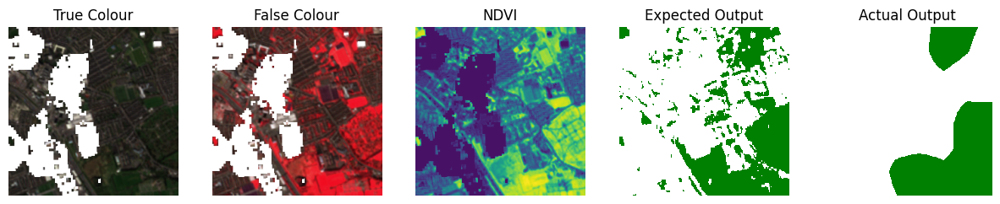

Epoch 2:
Training Loss: 0.389, Training Accuracy: 82.44%
Testing Accuracy: 83.00%
Epoch 3:
Training Loss: 0.371, Training Accuracy: 83.22%
Testing Accuracy: 83.30%
Epoch 4:
Training Loss: 0.364, Training Accuracy: 83.46%
Testing Accuracy: 83.43%
Epoch 5:
Training Loss: 0.358, Training Accuracy: 83.65%
Testing Accuracy: 83.58%


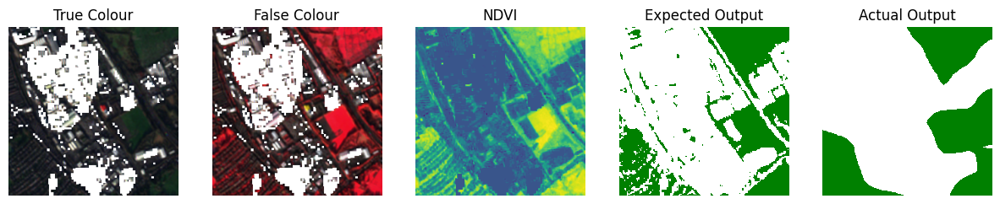

Epoch 6:
Training Loss: 0.356, Training Accuracy: 83.77%
Testing Accuracy: 83.65%
Epoch 7:
Training Loss: 0.354, Training Accuracy: 83.82%
Testing Accuracy: 83.69%
Epoch 8:
Training Loss: 0.352, Training Accuracy: 83.84%
Testing Accuracy: 83.70%
Epoch 9:
Training Loss: 0.352, Training Accuracy: 83.88%
Testing Accuracy: 83.73%
Epoch 10:
Training Loss: 0.352, Training Accuracy: 83.88%
Testing Accuracy: 83.75%


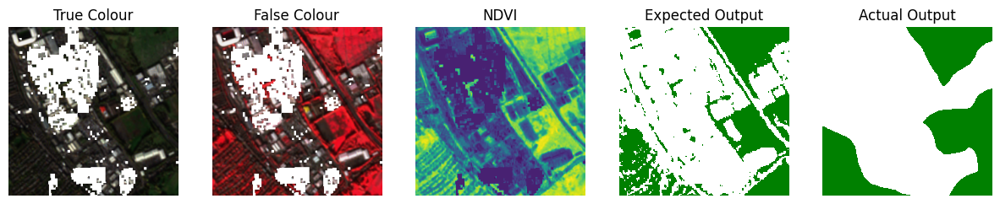

Epoch 11:
Training Loss: 0.351, Training Accuracy: 83.91%
Testing Accuracy: 83.74%
Epoch 12:
Training Loss: 0.351, Training Accuracy: 83.92%
Testing Accuracy: 83.76%
Epoch 13:
Training Loss: 0.350, Training Accuracy: 83.93%
Testing Accuracy: 83.75%
Epoch 14:
Training Loss: 0.351, Training Accuracy: 83.93%
Testing Accuracy: 83.80%
Epoch 15:
Training Loss: 0.350, Training Accuracy: 83.94%
Testing Accuracy: 83.76%


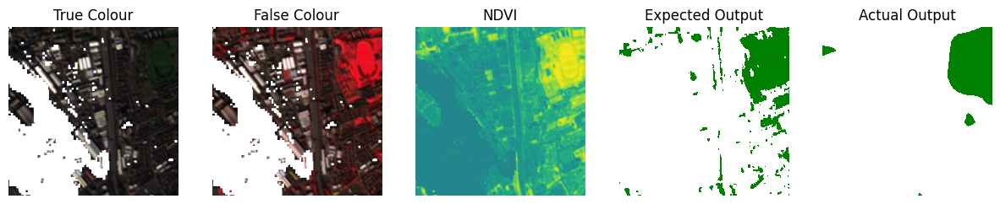

Epoch 16:
Training Loss: 0.350, Training Accuracy: 83.94%
Testing Accuracy: 83.75%
Epoch 17:
Training Loss: 0.350, Training Accuracy: 83.95%
Testing Accuracy: 83.81%
Epoch 18:
Training Loss: 0.350, Training Accuracy: 83.96%
Testing Accuracy: 83.77%
Epoch 19:
Training Loss: 0.350, Training Accuracy: 83.96%
Testing Accuracy: 83.81%
Epoch 20:
Training Loss: 0.350, Training Accuracy: 83.95%
Testing Accuracy: 83.80%


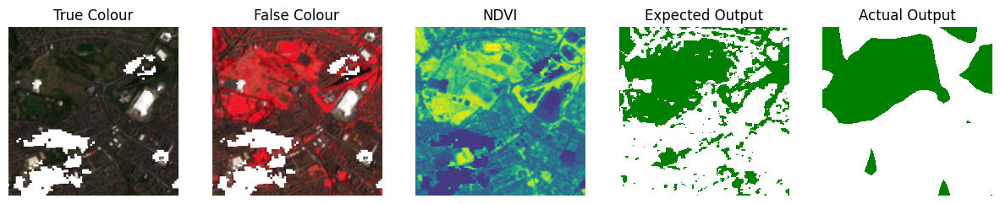

Epoch 21:
Training Loss: 0.350, Training Accuracy: 83.94%
Testing Accuracy: 83.76%
Epoch 22:
Training Loss: 0.350, Training Accuracy: 83.96%
Testing Accuracy: 83.79%
Epoch 23:
Training Loss: 0.350, Training Accuracy: 83.97%
Testing Accuracy: 83.79%
Epoch 24:
Training Loss: 0.350, Training Accuracy: 83.97%
Testing Accuracy: 83.78%
Epoch 25:
Training Loss: 0.350, Training Accuracy: 83.96%
Testing Accuracy: 83.79%


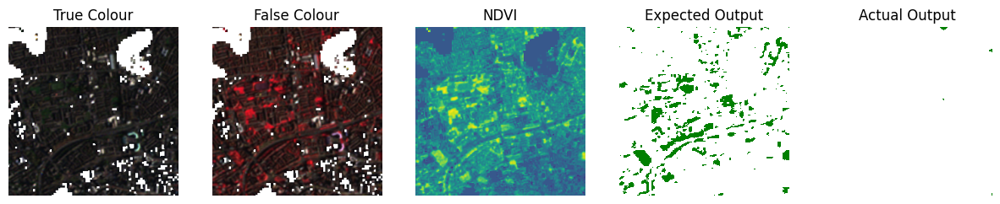

Epoch 26:
Training Loss: 0.350, Training Accuracy: 83.96%
Testing Accuracy: 83.79%
Epoch 27:
Training Loss: 0.350, Training Accuracy: 83.97%
Testing Accuracy: 83.79%
Epoch 28:
Training Loss: 0.350, Training Accuracy: 83.96%
Testing Accuracy: 83.80%
Epoch 29:
Training Loss: 0.350, Training Accuracy: 83.96%
Testing Accuracy: 83.81%
Epoch 30:
Training Loss: 0.350, Training Accuracy: 83.95%
Testing Accuracy: 83.79%


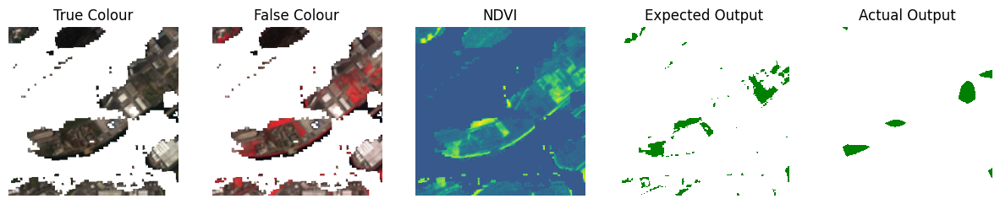

Epoch 31:
Training Loss: 0.349, Training Accuracy: 83.97%
Testing Accuracy: 83.80%
Epoch 32:
Training Loss: 0.350, Training Accuracy: 83.98%
Testing Accuracy: 83.81%
Epoch 33:
Training Loss: 0.349, Training Accuracy: 83.98%
Testing Accuracy: 83.81%
Epoch 34:
Training Loss: 0.349, Training Accuracy: 83.97%
Testing Accuracy: 83.82%
Epoch 35:
Training Loss: 0.349, Training Accuracy: 83.97%
Testing Accuracy: 83.84%


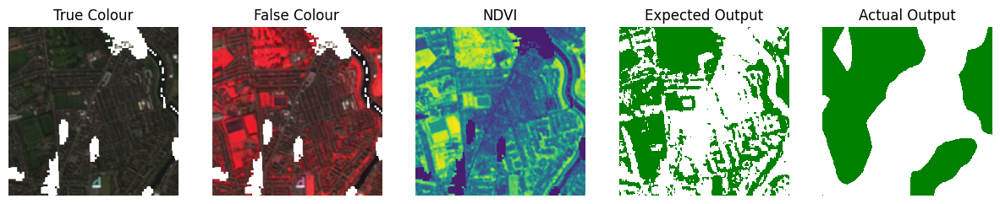

Epoch 36:
Training Loss: 0.349, Training Accuracy: 83.99%
Testing Accuracy: 83.83%
Epoch 37:
Training Loss: 0.349, Training Accuracy: 83.99%
Testing Accuracy: 83.82%
Epoch 38:
Training Loss: 0.350, Training Accuracy: 83.96%
Testing Accuracy: 83.77%
Epoch 39:
Training Loss: 0.350, Training Accuracy: 83.93%
Testing Accuracy: 83.80%
Epoch 40:
Training Loss: 0.349, Training Accuracy: 83.96%
Testing Accuracy: 83.84%


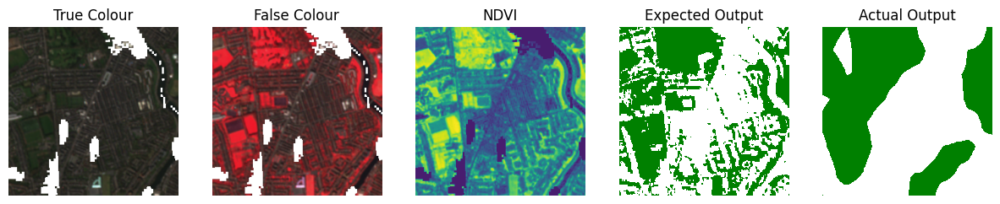

Epoch 41:
Training Loss: 0.349, Training Accuracy: 83.98%
Testing Accuracy: 83.82%
Epoch 42:
Training Loss: 0.349, Training Accuracy: 83.99%
Testing Accuracy: 83.81%
Epoch 43:
Training Loss: 0.349, Training Accuracy: 83.99%
Testing Accuracy: 83.82%
Epoch 44:
Training Loss: 0.349, Training Accuracy: 84.00%
Testing Accuracy: 83.83%
Epoch 45:
Training Loss: 0.349, Training Accuracy: 84.00%
Testing Accuracy: 83.86%


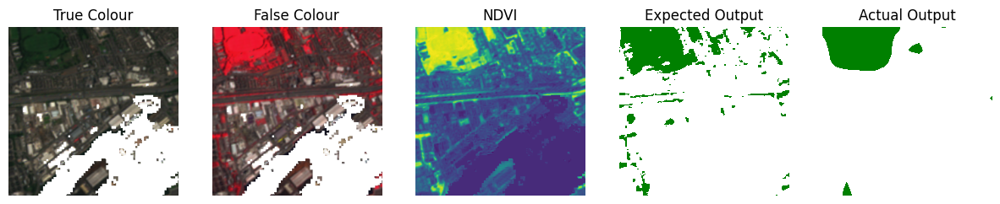

Epoch 46:
Training Loss: 0.349, Training Accuracy: 84.00%
Testing Accuracy: 83.85%
Epoch 47:
Training Loss: 0.349, Training Accuracy: 83.99%
Testing Accuracy: 83.82%
Epoch 48:
Training Loss: 0.349, Training Accuracy: 83.98%
Testing Accuracy: 83.82%
Epoch 49:
Training Loss: 0.350, Training Accuracy: 83.97%
Testing Accuracy: 83.83%
Epoch 50:
Training Loss: 0.349, Training Accuracy: 83.97%
Testing Accuracy: 83.84%


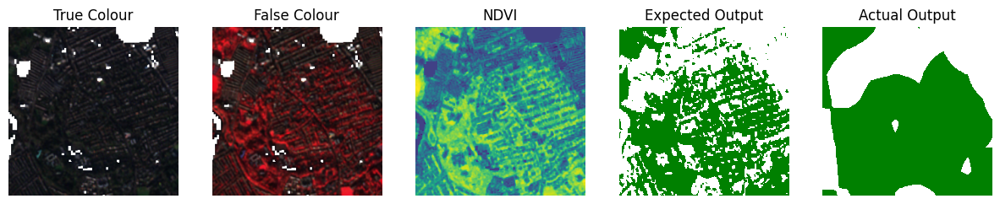

([79.44622608586761,
  82.43719294341373,
  83.21956080897428,
  83.45980028034916,
  83.64638372159621,
  83.77145118789218,
  83.81737316579041,
  83.84367106686057,
  83.8757721614648,
  83.88061220081853,
  83.90848300092027,
  83.91795073067455,
  83.92564989700469,
  83.93291981509381,
  83.94113468602448,
  83.94108766589913,
  83.94857903361084,
  83.96043265553166,
  83.96459772856998,
  83.95053567753634,
  83.94237692740045,
  83.95738544805387,
  83.96823041244718,
  83.9668016073481,
  83.96083915209913,
  83.96482221174904,
  83.96966680143747,
  83.96000795762534,
  83.96388029246397,
  83.94516931613444,
  83.96932097599947,
  83.97990505453606,
  83.98320253042293,
  83.9748117132168,
  83.9726336196687,
  83.9875754020797,
  83.99350903854219,
  83.96468266815124,
  83.92818139988196,
  83.96169158146822,
  83.98383957728241,
  83.99242909243756,
  83.99153571005607,
  83.99954429914652,
  83.99638485007921,
  84.00112174851283,
  83.9941278840628,
  83.97955467876336

In [23]:
"""
Author: Bhavana
"""
train(resnet_model, train_dataloader, test_dataloader, model_name='resnet', num_epochs=50)

#### Hybrid

Epoch 1:
Training Loss: 0.449, Training Accuracy: 78.19%
Testing Accuracy: 82.20%


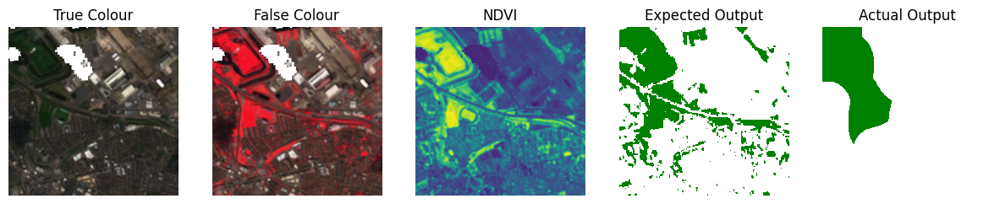

Epoch 2:
Training Loss: 0.378, Training Accuracy: 82.67%
Testing Accuracy: 83.11%
Epoch 3:
Training Loss: 0.364, Training Accuracy: 83.31%
Testing Accuracy: 83.41%
Epoch 4:
Training Loss: 0.357, Training Accuracy: 83.59%
Testing Accuracy: 83.60%
Epoch 5:
Training Loss: 0.353, Training Accuracy: 83.76%
Testing Accuracy: 83.68%


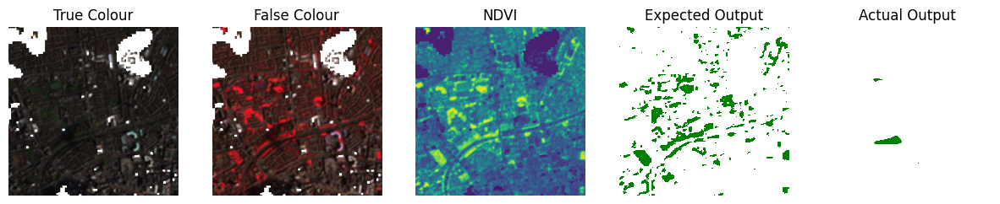

Epoch 6:
Training Loss: 0.351, Training Accuracy: 83.84%
Testing Accuracy: 83.75%
Epoch 7:
Training Loss: 0.350, Training Accuracy: 83.90%
Testing Accuracy: 83.76%
Epoch 8:
Training Loss: 0.348, Training Accuracy: 83.93%
Testing Accuracy: 83.81%
Epoch 9:
Training Loss: 0.348, Training Accuracy: 83.96%
Testing Accuracy: 83.84%
Epoch 10:
Training Loss: 0.347, Training Accuracy: 83.99%
Testing Accuracy: 83.84%


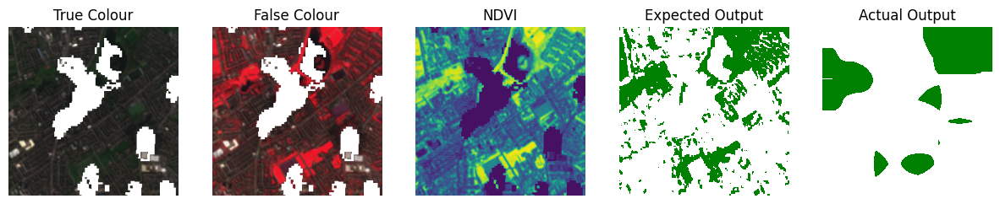

Epoch 11:
Training Loss: 0.347, Training Accuracy: 84.00%
Testing Accuracy: 83.83%
Epoch 12:
Training Loss: 0.347, Training Accuracy: 84.01%
Testing Accuracy: 83.85%
Epoch 13:
Training Loss: 0.347, Training Accuracy: 84.01%
Testing Accuracy: 83.87%
Epoch 14:
Training Loss: 0.346, Training Accuracy: 84.03%
Testing Accuracy: 83.89%
Epoch 15:
Training Loss: 0.346, Training Accuracy: 84.03%
Testing Accuracy: 83.88%


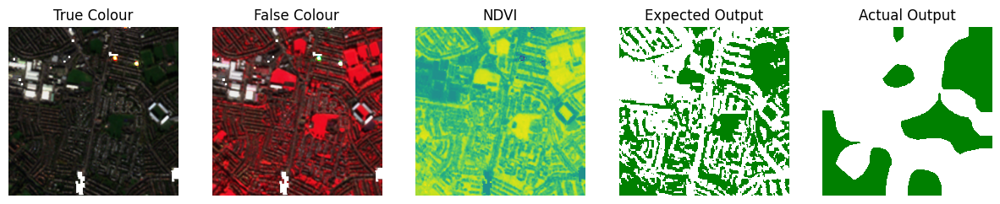

Epoch 16:
Training Loss: 0.346, Training Accuracy: 84.03%
Testing Accuracy: 83.91%
Epoch 17:
Training Loss: 0.346, Training Accuracy: 84.03%
Testing Accuracy: 83.90%
Epoch 18:
Training Loss: 0.346, Training Accuracy: 84.05%
Testing Accuracy: 83.90%
Epoch 19:
Training Loss: 0.345, Training Accuracy: 84.04%
Testing Accuracy: 83.91%
Epoch 20:
Training Loss: 0.345, Training Accuracy: 84.05%
Testing Accuracy: 83.91%


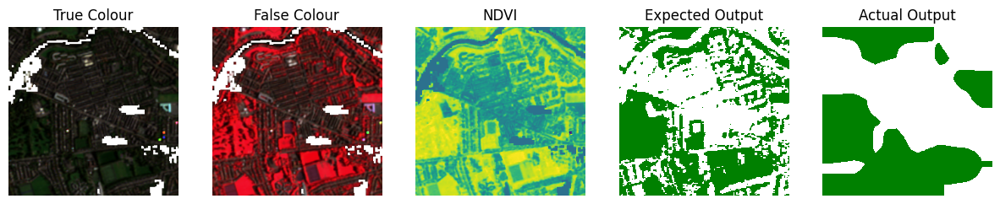

Epoch 21:
Training Loss: 0.345, Training Accuracy: 84.05%
Testing Accuracy: 83.90%
Epoch 22:
Training Loss: 0.345, Training Accuracy: 84.06%
Testing Accuracy: 83.92%
Epoch 23:
Training Loss: 0.345, Training Accuracy: 84.05%
Testing Accuracy: 83.91%
Epoch 24:
Training Loss: 0.345, Training Accuracy: 84.05%
Testing Accuracy: 83.94%
Epoch 25:
Training Loss: 0.345, Training Accuracy: 84.06%
Testing Accuracy: 83.91%


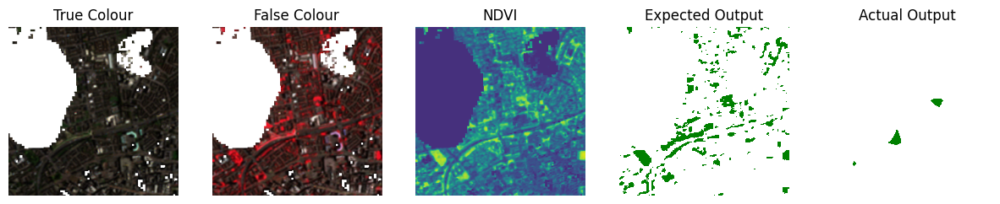

Epoch 26:
Training Loss: 0.345, Training Accuracy: 84.06%
Testing Accuracy: 83.92%
Epoch 27:
Training Loss: 0.345, Training Accuracy: 84.06%
Testing Accuracy: 83.91%
Epoch 28:
Training Loss: 0.345, Training Accuracy: 84.06%
Testing Accuracy: 83.92%
Epoch 29:
Training Loss: 0.345, Training Accuracy: 84.06%
Testing Accuracy: 83.92%
Epoch 30:
Training Loss: 0.345, Training Accuracy: 84.06%
Testing Accuracy: 83.93%


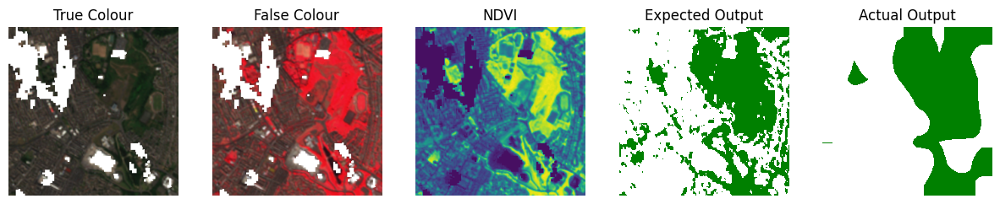

Epoch 31:
Training Loss: 0.345, Training Accuracy: 84.06%
Testing Accuracy: 83.94%
Epoch 32:
Training Loss: 0.345, Training Accuracy: 84.06%
Testing Accuracy: 83.89%
Epoch 33:
Training Loss: 0.345, Training Accuracy: 84.06%
Testing Accuracy: 83.94%
Epoch 34:
Training Loss: 0.345, Training Accuracy: 84.06%
Testing Accuracy: 83.93%
Epoch 35:
Training Loss: 0.345, Training Accuracy: 84.07%
Testing Accuracy: 83.94%


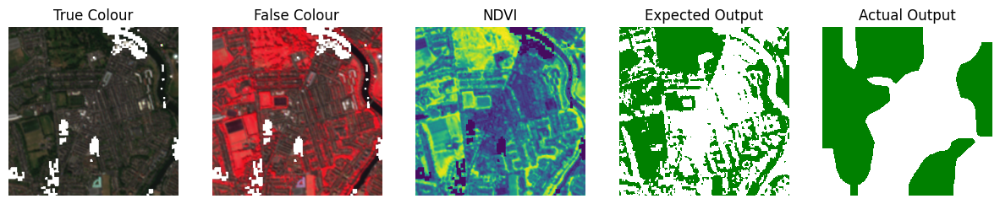

Epoch 36:
Training Loss: 0.345, Training Accuracy: 84.07%
Testing Accuracy: 83.94%
Epoch 37:
Training Loss: 0.345, Training Accuracy: 84.07%
Testing Accuracy: 83.93%
Epoch 38:
Training Loss: 0.344, Training Accuracy: 84.06%
Testing Accuracy: 83.94%
Epoch 39:
Training Loss: 0.345, Training Accuracy: 84.06%
Testing Accuracy: 83.94%
Epoch 40:
Training Loss: 0.345, Training Accuracy: 84.07%
Testing Accuracy: 83.94%


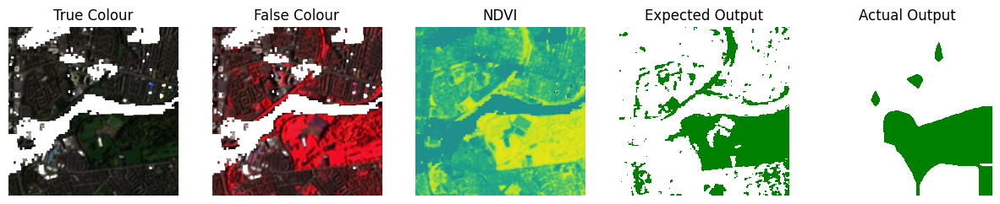

Epoch 41:
Training Loss: 0.345, Training Accuracy: 84.07%
Testing Accuracy: 83.93%
Epoch 42:
Training Loss: 0.344, Training Accuracy: 84.07%
Testing Accuracy: 83.95%
Epoch 43:
Training Loss: 0.344, Training Accuracy: 84.07%
Testing Accuracy: 83.94%
Epoch 44:
Training Loss: 0.344, Training Accuracy: 84.07%
Testing Accuracy: 83.93%
Epoch 45:
Training Loss: 0.345, Training Accuracy: 84.07%
Testing Accuracy: 83.94%


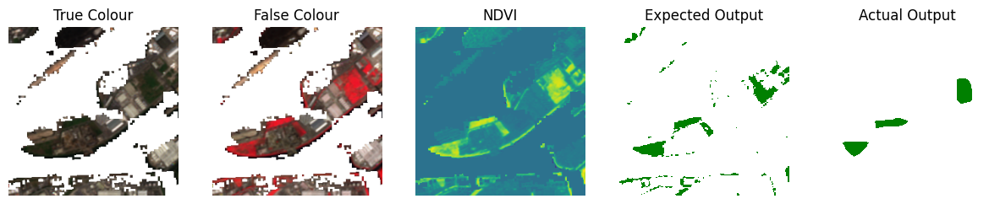

Epoch 46:
Training Loss: 0.345, Training Accuracy: 84.07%
Testing Accuracy: 83.95%
Epoch 47:
Training Loss: 0.345, Training Accuracy: 84.07%
Testing Accuracy: 83.94%
Epoch 48:
Training Loss: 0.344, Training Accuracy: 84.07%
Testing Accuracy: 83.95%
Epoch 49:
Training Loss: 0.344, Training Accuracy: 84.07%
Testing Accuracy: 83.94%
Epoch 50:
Training Loss: 0.345, Training Accuracy: 84.07%
Testing Accuracy: 83.95%


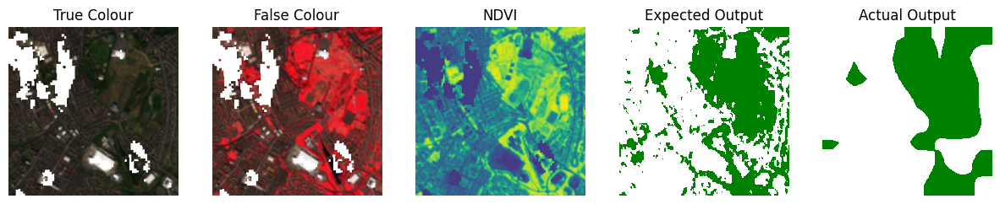

([78.19234192015874,
  82.67392258994859,
  83.30765680574754,
  83.58703522274556,
  83.75706606309409,
  83.84459326802855,
  83.90395845143979,
  83.93072655376336,
  83.9624150846872,
  83.9852896172768,
  83.99766349413285,
  84.00636373409931,
  84.00678691522738,
  84.02607578406514,
  84.02684479063122,
  84.03124193073978,
  84.03330474914186,
  84.05027901439021,
  84.04042905652025,
  84.04784913565481,
  84.05306836956775,
  84.0573365835262,
  84.05400422173987,
  84.05237520191352,
  84.06455341437702,
  84.05587592608413,
  84.05781436867079,
  84.060985951964,
  84.06092376405628,
  84.06446240768281,
  84.06270294492809,
  84.05808587197518,
  84.05623995286095,
  84.06269839459338,
  84.06845608478038,
  84.06642815227774,
  84.0665828636579,
  84.06244054229312,
  84.0635720588578,
  84.06680279650224,
  84.06924329268529,
  84.06959518523624,
  84.06597008525021,
  84.06994859456543,
  84.07214185589588,
  84.07301400338206,
  84.07367986902801,
  84.07022313142629,

In [24]:
"""
Author: Bhavana
"""
train(hybrid_model, train_dataloader, test_dataloader, model_name='hybrid', num_epochs=50)

#### UNet


Epoch 1:
Training Loss: 0.332, Training Accuracy: 88.97%
Testing Accuracy: 91.19%


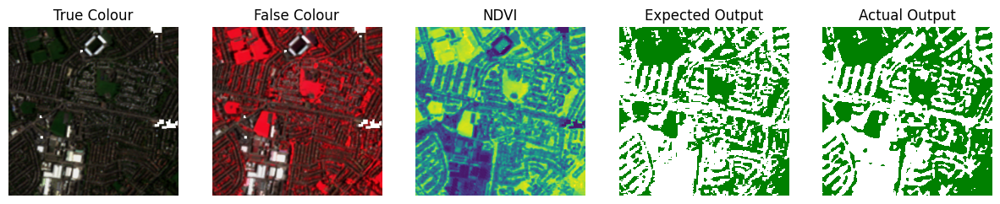

Epoch 2:
Training Loss: 0.277, Training Accuracy: 90.71%
Testing Accuracy: 90.26%
Epoch 3:
Training Loss: 0.258, Training Accuracy: 90.84%
Testing Accuracy: 91.23%
Epoch 4:
Training Loss: 0.246, Training Accuracy: 90.92%
Testing Accuracy: 91.29%
Epoch 5:
Training Loss: 0.234, Training Accuracy: 91.08%
Testing Accuracy: 91.58%


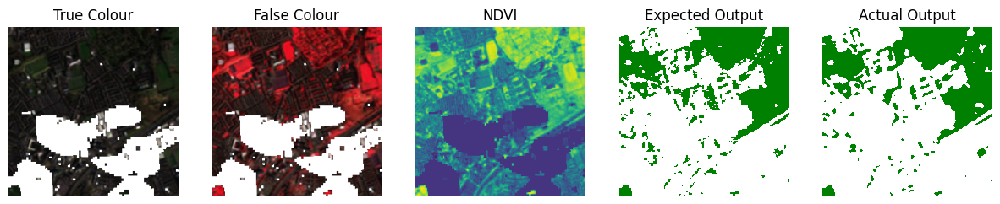

Epoch 6:
Training Loss: 0.225, Training Accuracy: 91.24%
Testing Accuracy: 91.35%
Epoch 7:
Training Loss: 0.217, Training Accuracy: 91.36%
Testing Accuracy: 91.51%
Epoch 8:
Training Loss: 0.212, Training Accuracy: 91.52%
Testing Accuracy: 91.40%
Epoch 9:
Training Loss: 0.204, Training Accuracy: 91.73%
Testing Accuracy: 91.93%
Epoch 10:
Training Loss: 0.200, Training Accuracy: 91.82%
Testing Accuracy: 92.07%


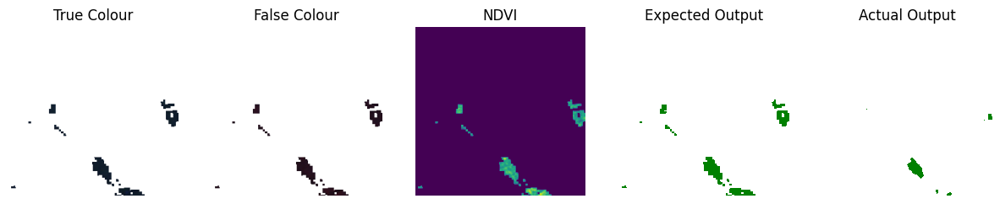

Epoch 11:
Training Loss: 0.192, Training Accuracy: 92.12%
Testing Accuracy: 92.36%
Epoch 12:
Training Loss: 0.185, Training Accuracy: 92.39%
Testing Accuracy: 91.75%
Epoch 13:
Training Loss: 0.175, Training Accuracy: 92.76%
Testing Accuracy: 92.76%
Epoch 14:
Training Loss: 0.168, Training Accuracy: 93.08%
Testing Accuracy: 92.52%
Epoch 15:
Training Loss: 0.152, Training Accuracy: 93.84%
Testing Accuracy: 94.20%


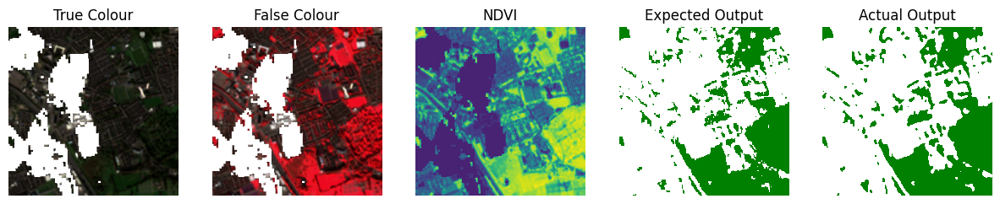

Epoch 16:
Training Loss: 0.131, Training Accuracy: 94.81%
Testing Accuracy: 95.25%
Epoch 17:
Training Loss: 0.112, Training Accuracy: 95.67%
Testing Accuracy: 95.90%
Epoch 18:
Training Loss: 0.096, Training Accuracy: 96.36%
Testing Accuracy: 96.47%
Epoch 19:
Training Loss: 0.083, Training Accuracy: 96.89%
Testing Accuracy: 96.97%
Epoch 20:
Training Loss: 0.071, Training Accuracy: 97.41%
Testing Accuracy: 97.37%


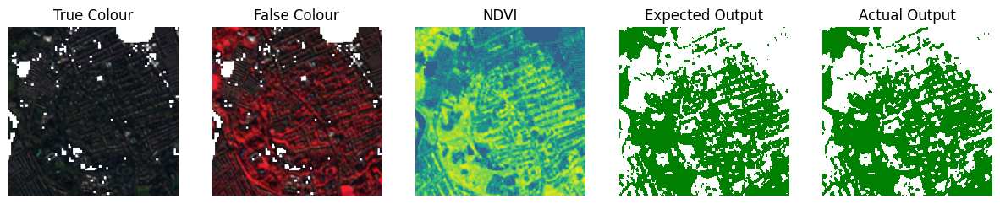

Epoch 21:
Training Loss: 0.060, Training Accuracy: 97.83%
Testing Accuracy: 97.79%
Epoch 22:
Training Loss: 0.053, Training Accuracy: 98.13%
Testing Accuracy: 98.02%
Epoch 23:
Training Loss: 0.047, Training Accuracy: 98.37%
Testing Accuracy: 98.26%
Epoch 24:
Training Loss: 0.040, Training Accuracy: 98.62%
Testing Accuracy: 98.51%
Epoch 25:
Training Loss: 0.033, Training Accuracy: 98.93%
Testing Accuracy: 98.76%


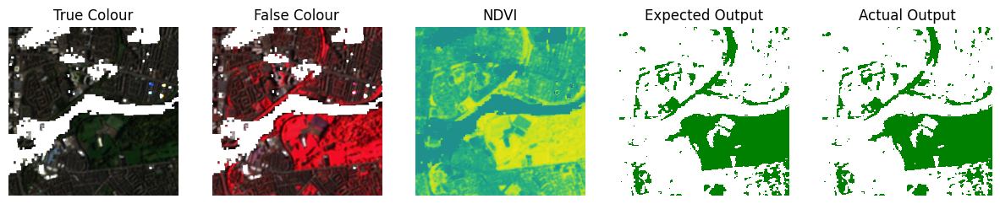

Epoch 26:
Training Loss: 0.029, Training Accuracy: 99.09%
Testing Accuracy: 99.01%
Epoch 27:
Training Loss: 0.023, Training Accuracy: 99.30%
Testing Accuracy: 99.21%
Epoch 28:
Training Loss: 0.018, Training Accuracy: 99.48%
Testing Accuracy: 99.34%
Epoch 29:
Training Loss: 0.015, Training Accuracy: 99.61%
Testing Accuracy: 99.28%
Epoch 30:
Training Loss: 0.012, Training Accuracy: 99.71%
Testing Accuracy: 99.56%


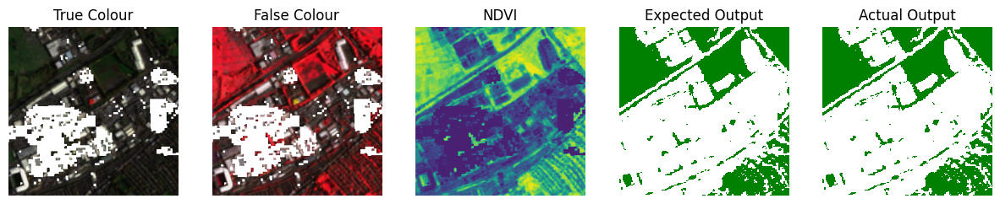

Epoch 31:
Training Loss: 0.009, Training Accuracy: 99.79%
Testing Accuracy: 99.63%
Epoch 32:
Training Loss: 0.008, Training Accuracy: 99.84%
Testing Accuracy: 99.64%
Epoch 33:
Training Loss: 0.007, Training Accuracy: 99.87%
Testing Accuracy: 99.70%
Epoch 34:
Training Loss: 0.006, Training Accuracy: 99.90%
Testing Accuracy: 99.72%
Epoch 35:
Training Loss: 0.005, Training Accuracy: 99.92%
Testing Accuracy: 99.77%


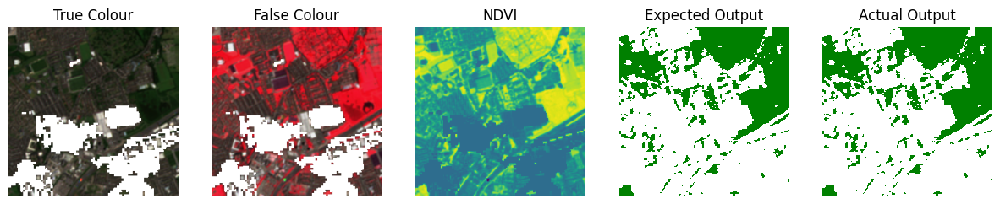

Epoch 36:
Training Loss: 0.004, Training Accuracy: 99.94%
Testing Accuracy: 99.76%
Epoch 37:
Training Loss: 0.003, Training Accuracy: 99.95%
Testing Accuracy: 99.78%
Epoch 38:
Training Loss: 0.003, Training Accuracy: 99.96%
Testing Accuracy: 99.80%
Epoch 39:
Training Loss: 0.003, Training Accuracy: 99.96%
Testing Accuracy: 99.79%
Epoch 40:
Training Loss: 0.003, Training Accuracy: 99.95%
Testing Accuracy: 99.80%


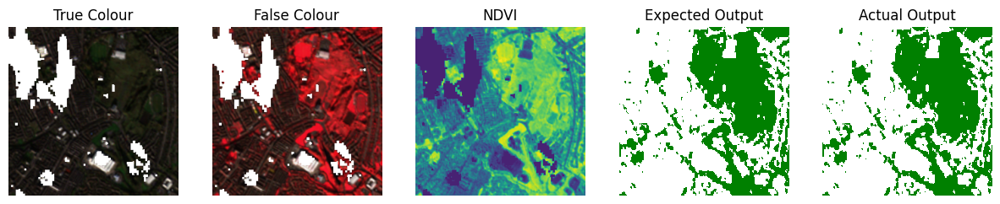

Epoch 41:
Training Loss: 0.003, Training Accuracy: 99.94%
Testing Accuracy: 99.79%
Epoch 42:
Training Loss: 0.003, Training Accuracy: 99.96%
Testing Accuracy: 99.82%
Epoch 43:
Training Loss: 0.002, Training Accuracy: 99.97%
Testing Accuracy: 99.81%
Epoch 44:
Training Loss: 0.002, Training Accuracy: 99.97%
Testing Accuracy: 99.82%
Epoch 45:
Training Loss: 0.002, Training Accuracy: 99.95%
Testing Accuracy: 99.82%


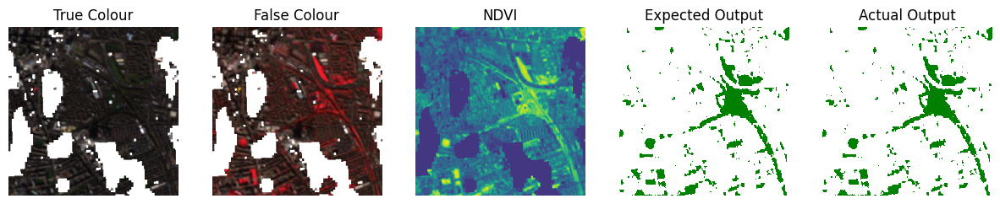

Epoch 46:
Training Loss: 0.002, Training Accuracy: 99.96%
Testing Accuracy: 99.83%
Epoch 47:
Training Loss: 0.002, Training Accuracy: 99.97%
Testing Accuracy: 99.85%
Epoch 48:
Training Loss: 0.001, Training Accuracy: 99.98%
Testing Accuracy: 99.86%
Epoch 49:
Training Loss: 0.001, Training Accuracy: 99.98%
Testing Accuracy: 99.85%
Epoch 50:
Training Loss: 0.001, Training Accuracy: 99.98%
Testing Accuracy: 99.84%


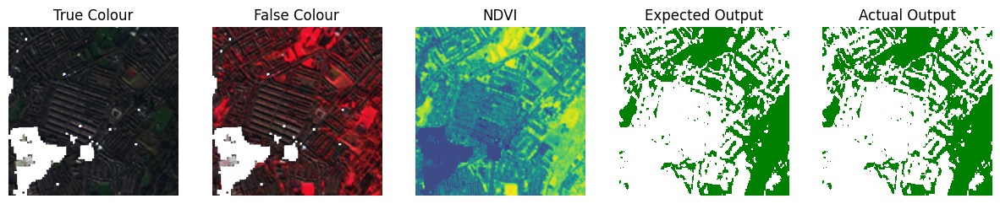

([88.97478774812065,
  90.71141540648686,
  90.83956799971654,
  90.92396760792666,
  91.08099965878557,
  91.2384033203125,
  91.35741429110882,
  91.51734338840006,
  91.73130922715659,
  91.81524166766977,
  92.11637978525332,
  92.38656349257968,
  92.75969245561785,
  93.07534159059317,
  93.84032869433788,
  94.81286718167557,
  95.67218879108164,
  96.36203470097384,
  96.89448756678678,
  97.41404175047373,
  97.83490069106844,
  98.13250623213841,
  98.36654359730291,
  98.61751427470334,
  98.93163146365946,
  99.09051398396728,
  99.30310410486301,
  99.48384643312002,
  99.6125298987326,
  99.70886503488833,
  99.78994441553802,
  99.83511558820902,
  99.86834668259972,
  99.8961871471367,
  99.91582032463423,
  99.9356082135119,
  99.94726465426193,
  99.95525049167884,
  99.95726932351205,
  99.947053822087,
  99.94491061443837,
  99.9553232970342,
  99.9683827576533,
  99.9667355364881,
  99.95018293558958,
  99.95944438350367,
  99.9725584481393,
  99.9811206612862,
  9

In [25]:
"""
Author: Bhavana
"""
train(unet_model_simple, train_dataloader, test_dataloader, model_name='unet_simple', num_epochs = 50)

#### UNet+

Epoch 1:
Training Loss: 0.382, Training Accuracy: 88.02%
Testing Accuracy: 89.39%


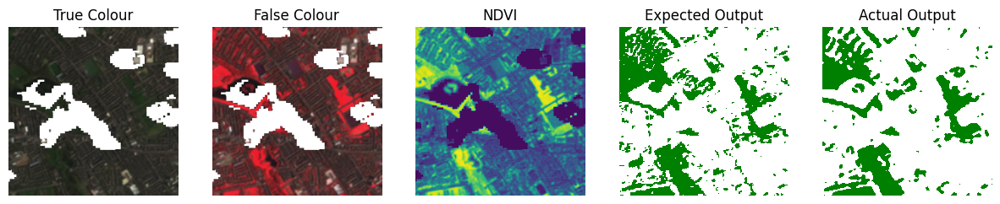

Epoch 2:
Training Loss: 0.321, Training Accuracy: 90.09%
Testing Accuracy: 90.51%
Epoch 3:
Training Loss: 0.292, Training Accuracy: 90.44%
Testing Accuracy: 90.53%
Epoch 4:
Training Loss: 0.270, Training Accuracy: 90.73%
Testing Accuracy: 91.18%
Epoch 5:
Training Loss: 0.259, Training Accuracy: 90.76%
Testing Accuracy: 91.21%


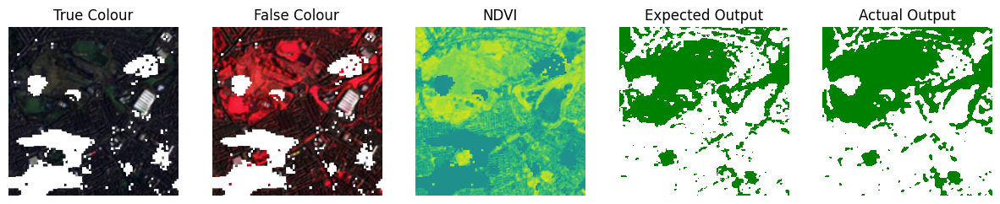

Epoch 6:
Training Loss: 0.248, Training Accuracy: 90.88%
Testing Accuracy: 90.42%
Epoch 7:
Training Loss: 0.235, Training Accuracy: 91.13%
Testing Accuracy: 91.06%
Epoch 8:
Training Loss: 0.224, Training Accuracy: 91.31%
Testing Accuracy: 91.63%
Epoch 9:
Training Loss: 0.220, Training Accuracy: 91.34%
Testing Accuracy: 91.86%
Epoch 10:
Training Loss: 0.213, Training Accuracy: 91.51%
Testing Accuracy: 91.96%


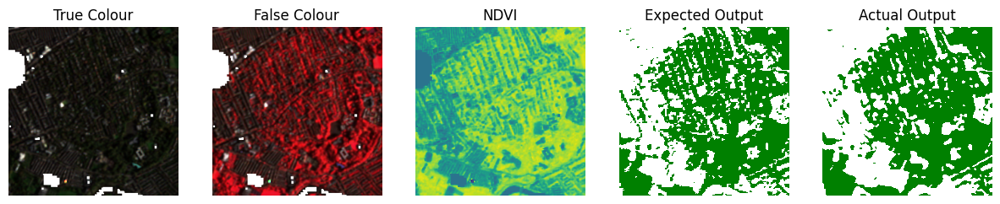

Epoch 11:
Training Loss: 0.210, Training Accuracy: 91.53%
Testing Accuracy: 92.02%
Epoch 12:
Training Loss: 0.202, Training Accuracy: 91.76%
Testing Accuracy: 91.83%
Epoch 13:
Training Loss: 0.199, Training Accuracy: 91.89%
Testing Accuracy: 92.23%
Epoch 14:
Training Loss: 0.195, Training Accuracy: 92.03%
Testing Accuracy: 91.94%
Epoch 15:
Training Loss: 0.187, Training Accuracy: 92.30%
Testing Accuracy: 92.72%


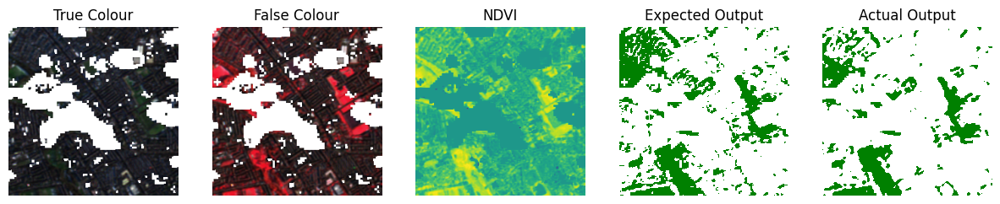

Epoch 16:
Training Loss: 0.176, Training Accuracy: 92.83%
Testing Accuracy: 93.36%
Epoch 17:
Training Loss: 0.162, Training Accuracy: 93.52%
Testing Accuracy: 93.97%
Epoch 18:
Training Loss: 0.138, Training Accuracy: 94.65%
Testing Accuracy: 95.13%
Epoch 19:
Training Loss: 0.119, Training Accuracy: 95.44%
Testing Accuracy: 95.71%
Epoch 20:
Training Loss: 0.103, Training Accuracy: 96.13%
Testing Accuracy: 96.34%


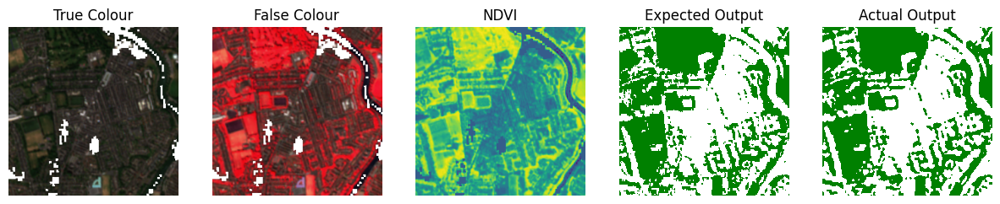

Epoch 21:
Training Loss: 0.090, Training Accuracy: 96.68%
Testing Accuracy: 96.87%
Epoch 22:
Training Loss: 0.078, Training Accuracy: 97.15%
Testing Accuracy: 97.30%
Epoch 23:
Training Loss: 0.069, Training Accuracy: 97.51%
Testing Accuracy: 97.61%
Epoch 24:
Training Loss: 0.060, Training Accuracy: 97.86%
Testing Accuracy: 97.93%
Epoch 25:
Training Loss: 0.052, Training Accuracy: 98.16%
Testing Accuracy: 98.23%


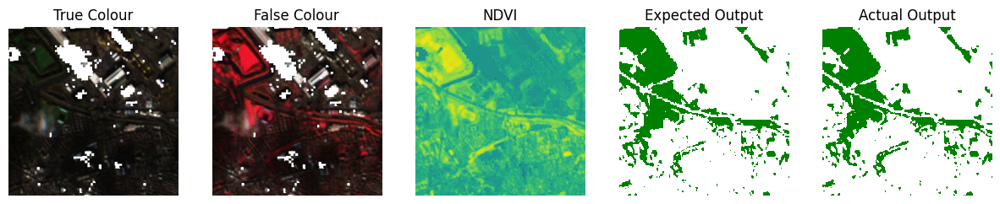

Epoch 26:
Training Loss: 0.046, Training Accuracy: 98.41%
Testing Accuracy: 98.49%
Epoch 27:
Training Loss: 0.041, Training Accuracy: 98.61%
Testing Accuracy: 98.71%
Epoch 28:
Training Loss: 0.035, Training Accuracy: 98.82%
Testing Accuracy: 98.93%
Epoch 29:
Training Loss: 0.030, Training Accuracy: 99.05%
Testing Accuracy: 99.05%
Epoch 30:
Training Loss: 0.024, Training Accuracy: 99.28%
Testing Accuracy: 99.35%


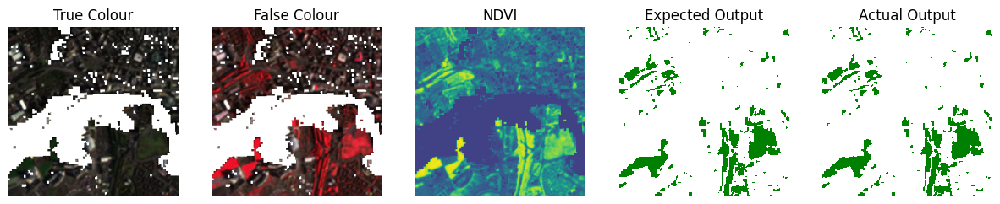

Epoch 31:
Training Loss: 0.019, Training Accuracy: 99.46%
Testing Accuracy: 99.47%
Epoch 32:
Training Loss: 0.016, Training Accuracy: 99.56%
Testing Accuracy: 99.50%
Epoch 33:
Training Loss: 0.014, Training Accuracy: 99.64%
Testing Accuracy: 99.60%
Epoch 34:
Training Loss: 0.011, Training Accuracy: 99.76%
Testing Accuracy: 99.64%
Epoch 35:
Training Loss: 0.009, Training Accuracy: 99.79%
Testing Accuracy: 99.78%


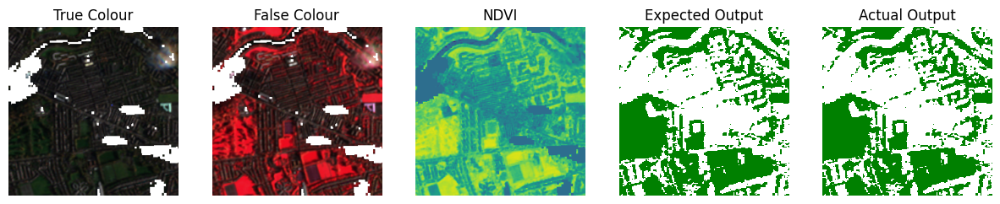

Epoch 36:
Training Loss: 0.009, Training Accuracy: 99.78%
Testing Accuracy: 99.76%
Epoch 37:
Training Loss: 0.007, Training Accuracy: 99.86%
Testing Accuracy: 99.83%
Epoch 38:
Training Loss: 0.006, Training Accuracy: 99.87%
Testing Accuracy: 99.82%
Epoch 39:
Training Loss: 0.005, Training Accuracy: 99.91%
Testing Accuracy: 99.86%
Epoch 40:
Training Loss: 0.004, Training Accuracy: 99.93%
Testing Accuracy: 99.88%


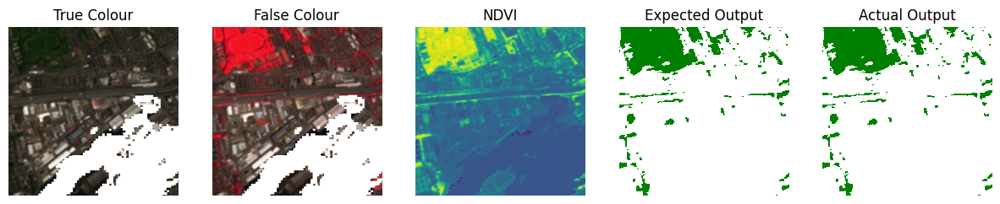

Epoch 41:
Training Loss: 0.004, Training Accuracy: 99.94%
Testing Accuracy: 99.88%
Epoch 42:
Training Loss: 0.004, Training Accuracy: 99.92%
Testing Accuracy: 99.88%
Epoch 43:
Training Loss: 0.003, Training Accuracy: 99.96%
Testing Accuracy: 99.90%
Epoch 44:
Training Loss: 0.003, Training Accuracy: 99.96%
Testing Accuracy: 99.90%
Epoch 45:
Training Loss: 0.003, Training Accuracy: 99.95%
Testing Accuracy: 99.90%


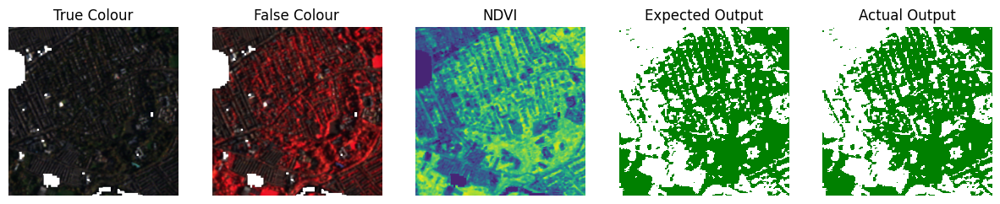

Epoch 46:
Training Loss: 0.002, Training Accuracy: 99.97%
Testing Accuracy: 99.87%
Epoch 47:
Training Loss: 0.011, Training Accuracy: 99.66%
Testing Accuracy: 99.87%
Epoch 48:
Training Loss: 0.002, Training Accuracy: 99.96%
Testing Accuracy: 99.91%
Epoch 49:
Training Loss: 0.002, Training Accuracy: 99.98%
Testing Accuracy: 99.92%
Epoch 50:
Training Loss: 0.003, Training Accuracy: 99.95%
Testing Accuracy: 99.91%


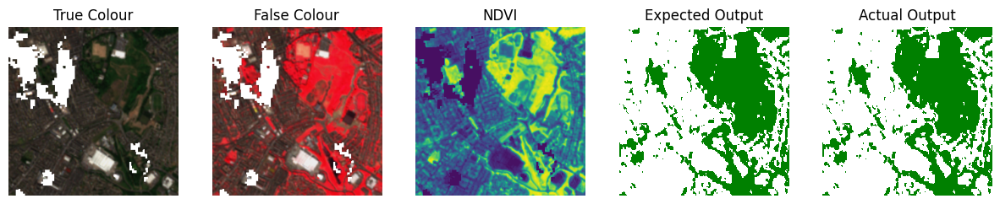

[UNet+] Elapsed time: 6287721.458570525


In [26]:
"""
Author: Bhavana
"""
unet_model_plus = UNet(extra_layer=True)
start_time = timer()
train(unet_model_plus, train_dataloader, test_dataloader, model_name='unet_plus', num_epochs = 50)
end_time = timer()
print(f"[UNet+] Elapsed time: {end_time}")

# Step 6: Evaluation

In [62]:
# Saving useful variables using pickle
"""
Author: Maria
"""
import pickle
import datetime

data_to_pickle = {"unet_model_plus": unet_model_plus,
                  "unet_model_simple": unet_model_simple,
                 "hybrid_model": hybrid_model,
                 "resnet_model": resnet_model,
                 "train_dataloader": train_dataloader,
                 "test_dataloader": test_dataloader,
                 "training_set_idx": training_set_idx,
                 "white_list_idx": white_list_idx,
                 "test_set_idx": test_set_idx,
                 "validation_set_idx": validation_set_idx,
                  "max_num_augmentations": max_num_augmentations,
                  "augmentation_transforms_list": augmentation_transforms_list,
                  "num_transforms": num_transforms
                 }
pickle.dump(data_to_pickle, open(f"snap_{datetime.datetime.now()}.p", "wb"))

# Pickle UNet only
pickle.dump({"unet_model_plus": unet_model_plus, "unet_model_simple": unet_model_simple}, 
            open(f"snap_unet_{datetime.datetime.now()}.p", "wb"))

In [37]:
# Instantiate the AugmentedDataset for validation data
validation_dataset = AugmentedDataset(validation_set_idx, validation_folder, num_transforms=2)

# Create a DataLoader for the validation dataset
validation_dataloader = DataLoader(validation_dataset, batch_size=batch_size, shuffle=True)

In [38]:
def evaluate_model_with_plots(hybrid_model, validation_dataloader, name):
    """
    Display ROC, confusion matrix, and display statistics.
    Author: Bhavana
    """
    
    hybrid_model.eval() # Set the model to evaluation mode
    predictions = [] # List to store all predictions
    true_labels = [] #  List to store all actual labels.
    
    # Disable gradient calculations to speed up the process and reduce memory usage
    with torch.no_grad():
        for batch, labels in validation_dataloader:
            outputs = hybrid_model(batch) # Get model output for the current batch
            preds = (outputs > 0.5).float().cpu().numpy().flatten() # Apply threshold to get binary predictions
            predictions.extend(preds) # Add predictions to the list
            true_labels.extend(labels.cpu().numpy().flatten())
    
    predictions = np.array(predictions) # Convert list of predictions to a numpy array
    true_labels = np.array(true_labels) # Convert list of true labels to a numpy array
    
    # Calculate True positive and false positive rate for evaluation
    fpr, tpr, _ = roc_curve(true_labels, predictions)
    # Calculate ROC curve and AUC for evaluation
    auc = roc_auc_score(true_labels, predictions)
    
    # Calculated the confusion matrix
    cm = confusion_matrix(true_labels, predictions)
    # Convert confusion matrix to percentage format for easier interpretation
    cm_percentage = np.round(cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100, 2)
    
    # Calculate precision, recall, and accuracy for models
    precision = precision_score(true_labels, predictions)
    recall = recall_score(true_labels, predictions)
    accuracy = accuracy_score(true_labels, predictions)
    
    # Plotting the ROC curve
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='green', lw=2, label=f'AUC = {auc:.2f}')
    plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
    plt.xlabel('False Positive Rate',fontsize=16) # Adding x-label
    plt.ylabel('True Positive Rate',fontsize=16) # Adding y-label
    plt.title(f'{name} - Receiver Operating Characteristic (ROC) Curve',fontsize=18) # Adding title to plot
    plt.legend(loc='lower right')
    plt.grid(True) # Display the grid
    plt.savefig(os.path.join(target_directory,f'{model_name}_figure_roc.png'))
    plt.show() # Display the plot

    # Plotting the confusion matrix
    plt.figure(figsize=(8, 6))
    plt.imshow(cm_percentage, interpolation='nearest', cmap=plt.cm.Greens)
    plt.title('Confusion Matrix (Percentage)',fontsize=18)  # Adding title to plot
    plt.colorbar()
    classes = ['Background', 'Green space'] # labels of class
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes)
    plt.yticks(tick_marks, classes)

    # Label each cell in the confusion matrix
    thresh = cm_percentage.max() / 2.
    for i, j in itertools.product(range(cm_percentage.shape[0]), range(cm_percentage.shape[1])):
        plt.text(j, i, f"{cm_percentage[i, j]:.2f}%",
                 horizontalalignment="center",
                 color="white" if cm_percentage[i, j] > thresh else "black")

    plt.ylabel('True label',fontsize=16) # Adding y-label
    plt.xlabel('Predicted label',fontsize=16) # Adding x-label
    plt.tight_layout()
    plt.show() # Display the plot
    # Print evaluation metrics
    print("Precision:", precision)
    print("Recall:", recall)
    print("Accuracy:", accuracy)
    print("Area Under the ROC Curve (AUC):", auc)

In [39]:
def plot_accuracy_from_csv(filename, name):
    """
    Display accuracy as number of epochs increases
    Author: Bhavana
    """
    # Read the CSV file into a pandas DataFrame
    df = pd.read_csv(filename)

    # Extract training and testing accuracy columns
    train_accuracy = df['Training Accuracy']
    test_accuracy = df['Testing Accuracy']

    # Plot the accuracy
    plt.figure(figsize=(10, 6))
    epochs = range(1, len(train_accuracy) + 1)
    plt.plot(epochs, train_accuracy, label='Training Accuracy', marker='o')
    plt.plot(epochs, test_accuracy, label='Testing Accuracy', marker='o')
    plt.title(f'Training/Testing Acc. ({name})')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy (%)')
    plt.legend()
    plt.grid(True)
    plt.savefig(f'images/{name}_training_progress.png', dpi=400)
    plt.show()



#### Resnet

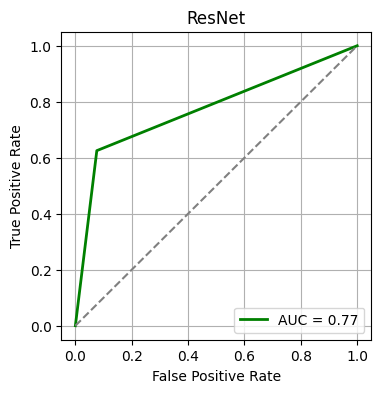

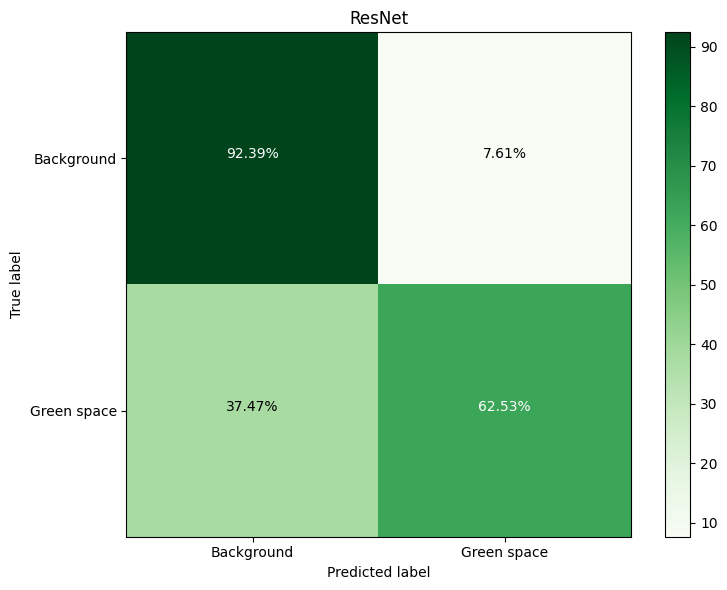

Precision: 0.7511953474780865
Recall: 0.625266627586863
Accuracy: 0.8436372086808488
Area Under the ROC Curve (AUC): 0.7745785318036211


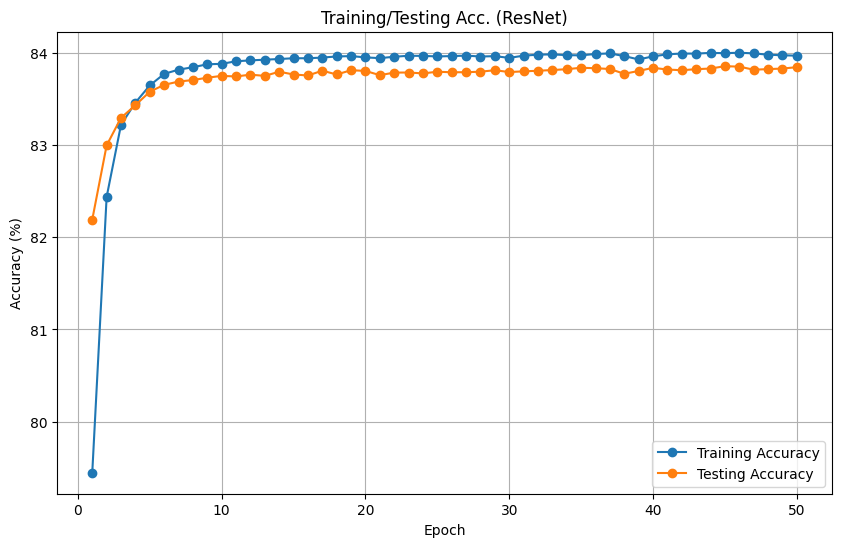

In [63]:
"""
Author: Bhavana
"""
evaluate_model_with_plots(resnet_model, validation_dataloader, 'ResNet')
plot_accuracy_from_csv('resnet_accuracy_history.csv', 'ResNet')

#### Hybrid


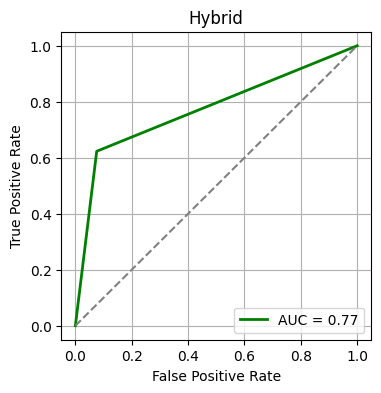

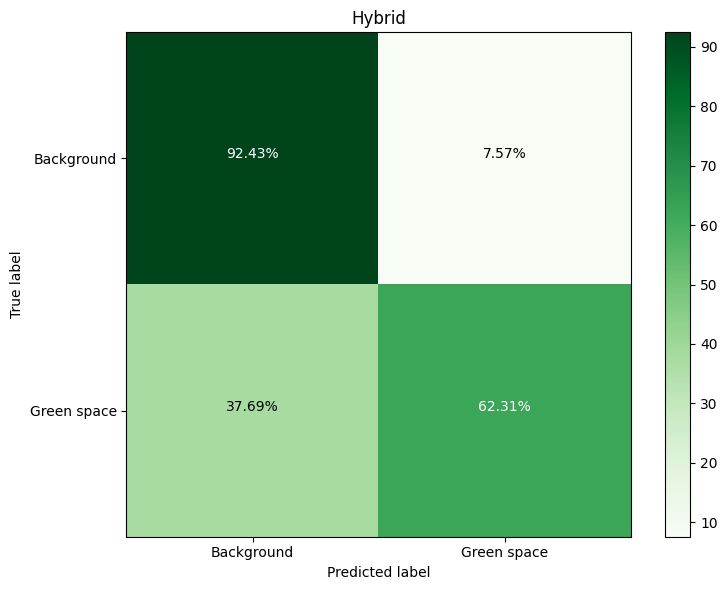

Precision: 0.7514201772040623
Recall: 0.6230576468024639
Accuracy: 0.8433068765176309
Area Under the ROC Curve (AUC): 0.7736540857838295


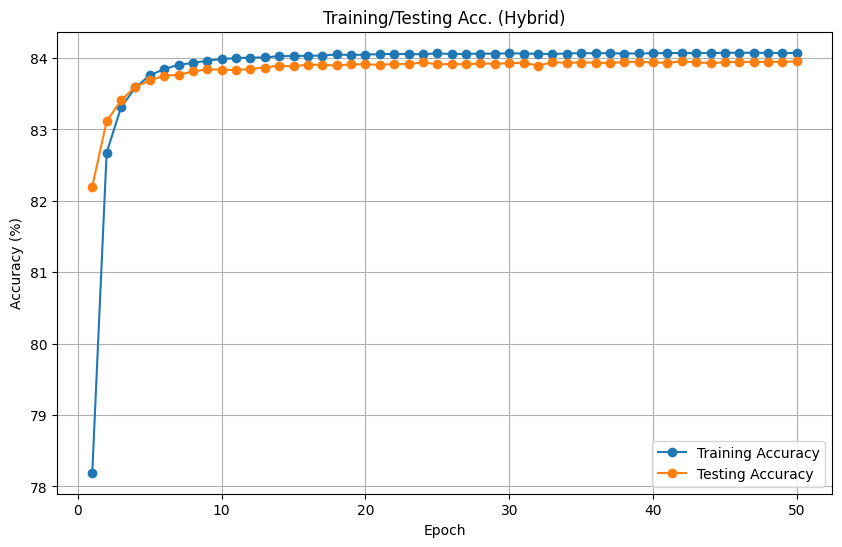

In [64]:
"""
Author: Bhavana
"""
evaluate_model_with_plots(hybrid_model, validation_dataloader, 'Hybrid')
plot_accuracy_from_csv('hybrid_accuracy_history.csv', 'Hybrid')

#### UNet+

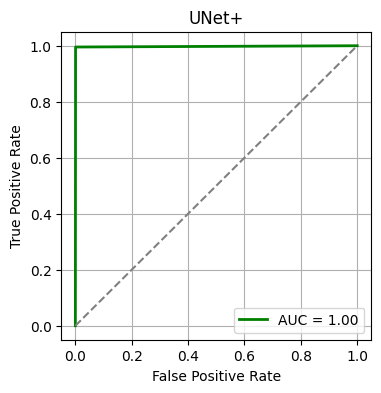

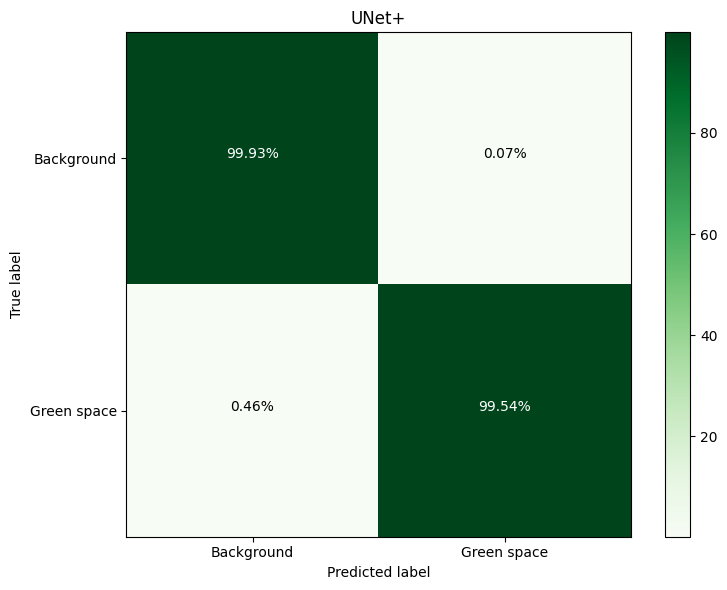

Precision: 0.9980658488453948
Recall: 0.9953695036353425
Accuracy: 0.9982371974635769
Area Under the ROC Curve (AUC): 0.9973303026773161


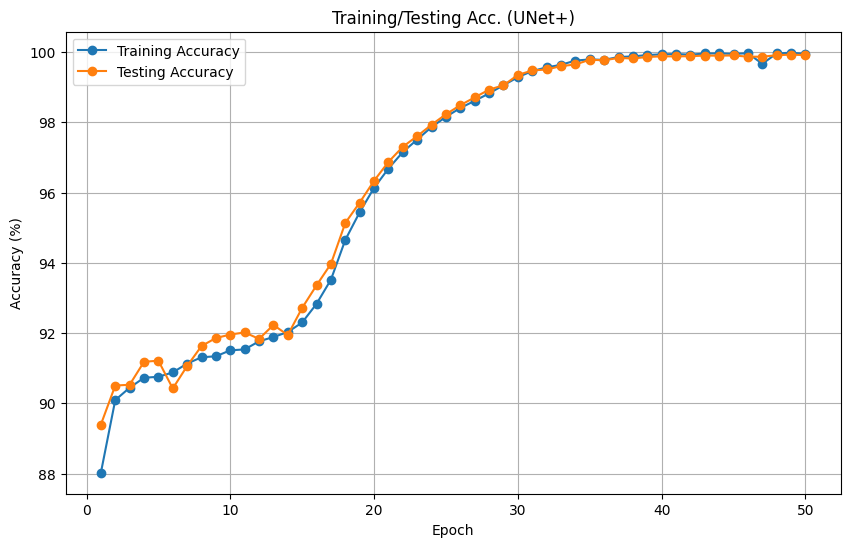

In [65]:
"""
Author: Bhavana
"""
evaluate_model_with_plots(unet_model_plus, validation_dataloader, 'UNet+')
plot_accuracy_from_csv('unet_plus_accuracy_history.csv', 'UNet+')

#### UNet

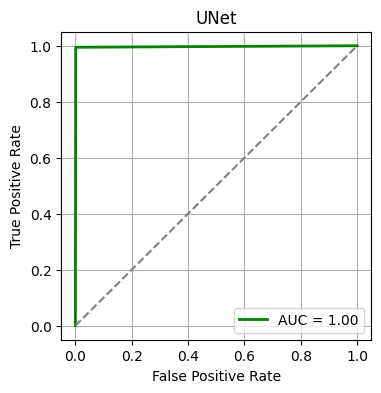

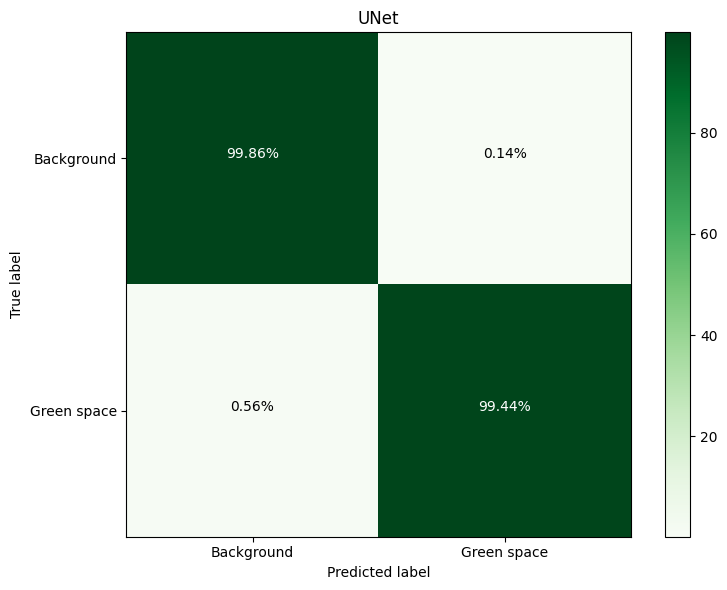

Precision: 0.9962465082456904
Recall: 0.9944165497853168
Accuracy: 0.9974926097972973
Area Under the ROC Curve (AUC): 0.9965198201781181


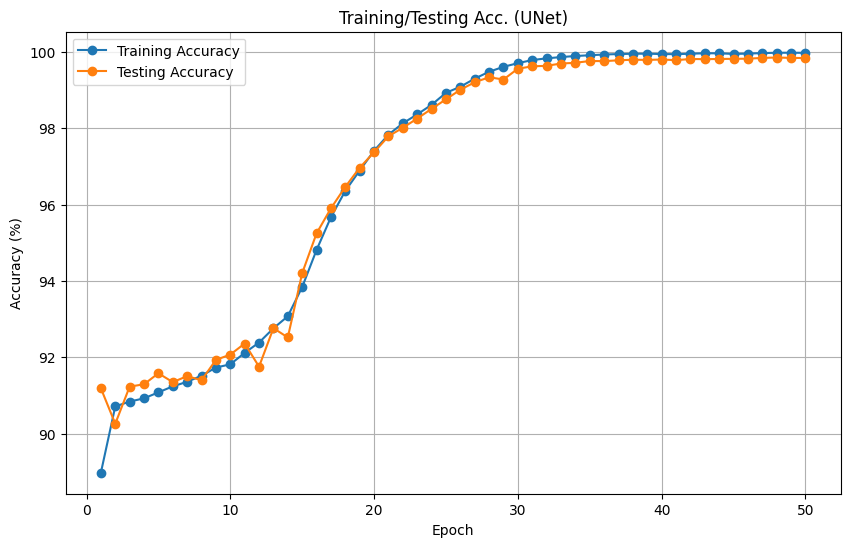

In [66]:
"""
Author: Bhavana
"""
evaluate_model_with_plots(unet_model_simple, validation_dataloader, 'UNet')
plot_accuracy_from_csv('unet_simple_accuracy_history.csv', 'UNet')

# Step 7: Decision for Best Model

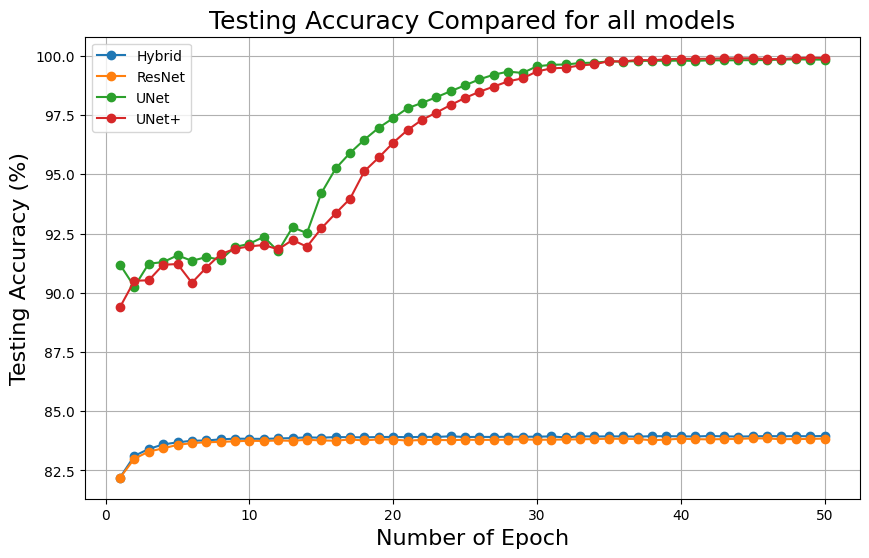

In [67]:
def plot_test_accuracy_from_multiple_csv(csv_filenames, legend_labels):
    """
    Decision for best model out of all four models
    Author: Bhavana
    """
    # Initialize a new figure for plotting
    plt.figure(figsize=(10, 6))
 
    for csv_filename, legend_label in zip(csv_filenames, legend_labels):
        # Read the CSV file to a pandas Dataframe
        df = pd.read_csv(csv_filename) 
 
        # Extract the 'Testing Accuracy' field from the Dataframe
        test_accuracy = df['Testing Accuracy']
 
        # Plot the testing accuracy for each epoch with marker o
        epochs = range(1, len(test_accuracy) + 1)
        plt.plot(epochs, test_accuracy, label=legend_label, marker = 'o')
 
    # Configure the plot with title, label, legend, and grid for our plot 
    plt.title('Testing Accuracy Compared for all models', fontsize=18) # Adding title to the plot
    plt.xlabel('Number of Epoch', fontsize=16) # Adding the x-label
    plt.ylabel('Testing Accuracy (%)', fontsize=16) # Adding the y-label
    plt.legend()
    plt.grid(True) # Display the grid for our plot
    plt.savefig('images/all_models_testing_accuracy.png', dpi=400)
    plt.show()
 # Specify the filename of all the CSV file containing the test accuracy data
csv_filenames = ["hybrid_accuracy_history.csv", "resnet_accuracy_history.csv", "unet_simple_accuracy_history.csv", "unet_plus_accuracy_history.csv"]
 
# Specify the legend labels for each CSV files
legend_labels = ["Hybrid", "ResNet", "UNet", "UNet+"]
 
# Plot test accuracy result from all CSV files with custom legend labels
plot_test_accuracy_from_multiple_csv(csv_filenames, legend_labels)

# Step 8: Demonstration
Code to show the results for all of Belfast area

In [68]:
# Taking a picture for demonstration
def select_image(image_id):
    # Opens the true color image with given ID
    true_image = Image.open(f'S2_chips/{image_id}/True_Colour.png')
    # Opens the corresponding image label
    image_label = Image.open(f"S2_True_Colour_Masked/True_Colour_M_{image_id}_label.png")
    return true_image, image_label

# Define an image ID for testing
img_id = "20220326"
# Loading image and label for selected ID
image, label = select_image(img_id)
 
labels_unet = []
# Loop over row and column
for row_ind in range(4):
    for col_ind in range(4):
        # Load the augmented image
        augm_im = torch.load(f"S2_Augmented/{img_id}_{row_ind}_{col_ind}_0_img.pt")
        # Reshape the image tensor to match the expected input
        augm_im = torch.reshape(augm_im, (1, 7, 256, 256))
        # Run the model to get the prediction
        model_pred = unet_model(augm_im)
        # Store the row and column indices
        labels_unet += [ (row_ind, col_ind, model_pred) ]
 

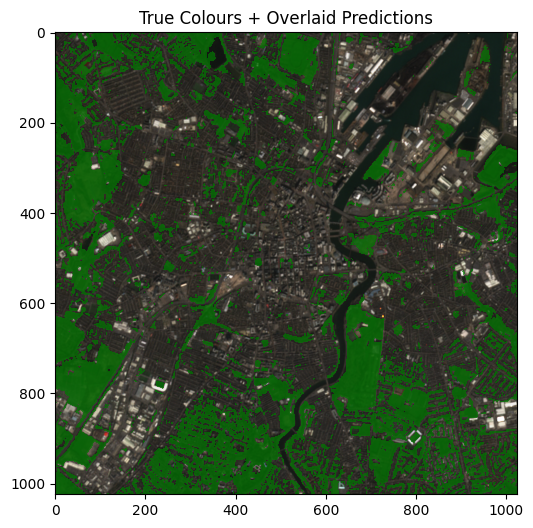

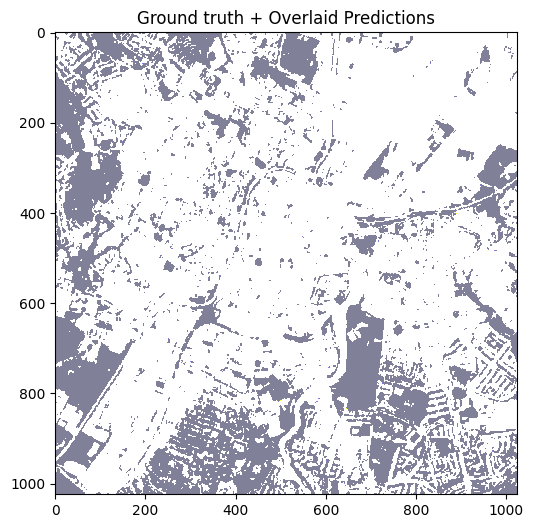

In [69]:
# Initialize a 2D array
big_image_labels = np.zeros((1024, 1024))

# Iterate over each prediction which is stored in labels_unet
for triplet in labels_unet:
    my_row = triplet[0] # The row index 
    my_col = triplet[1] # The column index
    my_labels = triplet[2] # The predicted labels tensor
    my_labels = my_labels[0, 0, :, :] # Reshape the labels tensor
    my_labels_np = my_labels.detach().cpu().numpy() # Converting the tensor to a NumPy array
    big_image_labels[my_row*256:(my_row+1)*256, 0+my_col*256:(my_col+1)*256] = my_labels_np


# Define a colormap which uses green to highlight predicted areas
greenspace_urban_cmap = ListedColormap([(0,0,0,0), 'green'])
# Display the true color image
plt.imshow(image)
plt.imshow(big_image_labels, alpha=0.65, cmap=greenspace_urban_cmap)
# Setting the title of the plot
plt.title('True Colours + Overlaid Predictions', fontsize=18)
# Saving the plot to a file
plt.savefig("true_colours_vs_predictions_unet_plus.png", dpi=600)
plt.show()

# Define colormaps for ground truth and predictions
greenspace_urban_cmap_yellow = ListedColormap([(0,0,0,0), 'yellow'])
greenspace_urban_cmap_blue = ListedColormap([(0,0,0,0), 'blue'])
# Display the ground truth labels
plt.imshow(label, alpha=0.8, cmap=greenspace_urban_cmap_yellow)
plt.imshow(big_image_labels, alpha=0.5, cmap=greenspace_urban_cmap_blue)
# Setting the title of the plot
plt.title('Ground truth + Overlaid Predictions', fontsize=18)
# Saving the plot to a file
plt.savefig("ground_truth_vs_predictions_unet_plus.png", dpi=600)
plt.show()

#code by Aleena- Not Working

In [1]:
#Step 3: Dataset Generation

In [ ]:
# prompt: generate dataset

import numpy as np
# Load the images and labels
images = []
labels = []

for i, row in masking_df.iterrows():
    image = open_image(row.True_Colour_M_path)
    label = open_image(row.True_Colour_M_label_path)

    images.append(image)
    labels.append(label)

# Convert the lists to numpy arrays
images = np.array(images)
labels = np.array(labels)

# Split the dataset into training and testing sets
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Save the datasets
np.save("X_train.npy", X_train)
np.save("X_test.npy", X_test)
np.save("y_train.npy", y_train)
np.save("y_test.npy", y_test)



In [ ]:
#Step 4: Training

In [ ]:
# prompt: train 

# import numpy as np
# # Load the training data
# X_train = np.load("X_train.npy")
# y_train = np.load("y_train.npy")


# prompt:  use SVM and random forest to train 

# from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier

# Train the SVM model
# svm_model = SVC(kernel='linear', C=1.0)
# svm_model.fit(X_train.reshape(-1, 3), y_train.ravel())

# Train the Random Forest model
rf_model = RandomForestClassifier(n_estimators=100, max_depth=5)
rf_model.fit(X_train.reshape(-1, 3), y_train.ravel())

# # Train the model
# # You can choose any machine learning model for image classification, such as CNN, SVM, or Random Forest.
# # Here, we use a simple CNN model as an example.
# model = tf.keras.Sequential([
#     tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_height, img_width, 3)),
#     tf.keras.layers.MaxPooling2D((2, 2)),
#     tf.keras.layers.Conv2D(64, (3, 3), activation='relu'),
#     tf.keras.layers.MaxPooling2D((2, 2)),
#     tf.keras.layers.Flatten(),
#     tf.keras.layers.Dense(128, activation='relu'),
#     tf.keras.layers.Dense(2, activation='softmax')
# ])

# model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# model.fit(X_train, y_train, epochs=10)

# # Save the model
# model.save("model.h5")


In [ ]:
#Step 5: Evaluation

In [ ]:
# prompt: make some evaluation

# import numpy as np
# Load the test data
# X_test = np.load("X_test.npy")
# y_test = np.load("y_test.npy")

# Evaluate the model
# loss, accuracy = model.evaluate(X_test, y_test)

# print("Loss:", loss)
# print("Accuracy:", accuracy)

# Make predictions on the test data
# y_pred = model.predict(X_test)

# Save the predictions
# np.save("y_pred.npy", y_pred)
# Predict the labels for the test set
# svm_preds = svm_model.predict(X_test.reshape(-1, 3))
rf_preds = rf_model.predict(X_test.reshape(-1, 3))
# rf_preds = rf_model.predict(X_test[1,-1])

In [ ]:
print(f"{rf_preds}")

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Reshape rf_preds into a 2D array with 20 rows and 629145 columns
image_data = rf_preds.reshape(-1, 3)

# Display the image
plt.imshow(image_data, cmap='viridis')  # You can choose a different colormap if you prefer
plt.axis('off')  # Turn off axes
plt.show()
print(f"{y_test}")
#Accuracy Score
from sklearn.metrics import accuracy_score
# Calculate the accuracy score for the Random Forest model
rf_accuracy = accuracy_score(y_test.ravel(), rf_preds)

# Print the accuracy score
print(f"Random Forest Accuracy: {rf_accuracy}")